### Problem Statement:
This dataset utilizes data from 2014 Major League Baseball seasons in order to develop an algorithm that predicts the number of wins for a given team in the 2015 season based on several different indicators of success. There are 16 different features that will be used as the inputs to the machine learning and the output will be a value that represents the number of wins.

Input features: Runs, At Bats, Hits, Doubles, Triples, Homeruns, Walks, Strikeouts, Stolen Bases, Runs Allowed, Earned Runs, Earned Run Average (ERA), Shutouts, Saves, Complete Games and Errors

Output: Number of predicted wins (W)

To understand the columns meaning, follow the link given below to understand the baseball statistics:  https://en.wikipedia.org/wiki/Baseball_statistics

For downloading the dataset, use the link given below.

Downlaod Files: https://github.com/dsrscientist/Data-Science-ML-Capstone-Projects/blob/master/baseball.csv

#### import the neccessary library

In [1]:
# import the library
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
# read the data
data=pd.read_csv('https://raw.githubusercontent.com/FlipRoboTechnologies/ML_-Datasets/main/Baseball/baseball.csv')
data

,W,R,AB,H,2B,3B,HR,BB,SO,SB,RA,ER,ERA,CG,SHO,SV,E
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


##### Comment -
This dataset contains 16 features which contains statistics summary of the Baseball players and the 'W' (wins) is the target variable which predicts the number of wins.
Input features in this dataset are : Runs, At Bats, Hits, Doubles, Triples, Homeruns, Walks, Strikeouts, Stolen Bases, Runs Allowed, Earned Runs, Earned Run Average (ERA), Shutouts, Saves, Complete Games and Errors
Target features : Number of predicted wins (W).

In [3]:
# Check the No. of rows and columns
data.shape

(30, 17)

In [4]:
# Check the data type
data.dtypes

W        int64
R        int64
AB       int64
H        int64
2B       int64
3B       int64
HR       int64
BB       int64
SO       int64
SB       int64
RA       int64
ER       int64
ERA    float64
CG       int64
SHO      int64
SV       int64
E        int64
dtype: object

here we get all colummn is a numeric data types.

In [7]:
# Check the columns
data.columns

Index(['W', 'R', 'AB', 'H', '2B', '3B', 'HR', 'BB', 'SO', 'SB', 'RA', 'ER',
       'ERA', 'CG', 'SHO', 'SV', 'E'],
      dtype='object')

##### Pitching statistics:
    1 . W – Win: number of games where pitcher was pitching while their team took the lead and went on to win, also the starter needs to pitch at least 5 innings of work
    2 . RA – Run average: number of runs allowed times nine divided by innings pitched
    3 . ER – Earned run: number of runs that did not occur as a result of errors or passed balls
    4 . ERA – Earned run average: total number of earned runs (see "ER" above), multiplied by 9, divided by innings pitched
    5 . CG – Complete game: number of games where player was the only pitcher for their team
    6 . SHO – Shutout: number of complete games pitched with no runs allowed. A starting pitcher is credited with a shutout when  he pitches the entire game for a team and does not allow the opposition to score. By definition, any pitcher who throws as shutout is also awarded a win.
    7 . SV – Save: number of games where the pitcher enters a game led by the pitcher's team, finishes the game without surrendering the lead, is not the winning pitcher, and either
    (a) the lead was three runs or fewer when the pitcher entered the game; 
    (b) the potential tying run was on base, at bat, or on deck; or 
    (c) the pitcher pitched three or more innings

##### Batting statistics:
    1. R – Runs scored: number of times a player crosses home plate
    2. AB – At bat: plate appearances, not including bases on balls, being hit by pitch, sacrifices, interference, or obstruction. The number of times in which the hitter appeared at the plate and made a base hit, reached base on an error, or was out.
    3. H – Hit: reaching base because of a batted, fair ball without error by the defense
    4. 2B – Double: hits on which the batter reaches second base safely without the contribution of a fielding error
    5. 3B – Triple: hits on which the batter reaches third base safely without the contribution of a fielding error
    6. HR – Home runs: hits on which the batter successfully touched all four bases, without the contribution of a fielding error
    7. BB – Base on balls (also called a "walk"): hitter not swinging at four pitches called out of the strike zone and awarded first base.A walk (or base on balls) occurs when a pitcher throws four pitches out of the strike zone, none of which are swung at by the hitter. After refraining from swinging at four pitches out of the zone, the batter is awarded first base.
    8. K – Strike out (also abbreviated SO): number of times that a third strike is taken or swung at and missed, or bunted foul. Catcher must catch the third strike or batter may attempt to run to first base. It usually means the batter is out.

##### Base running statistics:
    1. SB – Stolen base: number of bases advanced by the runner while the ball is in the possession of the defense.A stolen base occurs when a baserunner advances by taking a base to which he isn't entitled. This generally occurs when a pitcher is throwing a pitch, but it can also occur while the pitcher still has the ball or is attempting a pickoff, or as the catcher is throwing the ball back to the pitcher.
    2. R – Runs scored: times reached home plate legally and safely

##### Fielding statistics:
    1. E – Errors: number of times a fielder fails to make a play he should have made with common effort, and the offense benefits as a result. An error is an act, in the judgment of the official scorer, of a fielder misplaying a ball in a manner that allows a batter or baserunner to advance one or more bases or allows a plate appearance to continue after the batter should have been put out.

###### Now that we have clear understanding on what the abbreviation means and In order to simplify we are going to rename columns in dataset.

In [8]:
# rename the column
data.columns=['No_of_wins','Runs_scored','At_bat','Hit','two_bagger','three_bagger','home_runs','walks','strikeout','stolen_base',
             'run_average','earned_run','earned_run_average','complete_game','shutout','save','errors']

In [9]:
data

,No_of_wins,Runs_scored,At_bat,Hit,two_bagger,three_bagger,home_runs,walks,strikeout,stolen_base,run_average,earned_run,earned_run_average,complete_game,shutout,save,errors
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


In [10]:
# check the duplicates
data.duplicated().sum()

0

# Null values check

In [11]:
null_values = data.isnull().sum().sort_values(ascending = False)
per_null =(null_values/len(data))*100
print(pd.concat([null_values, per_null], axis =1, keys =['Null Values', ' %NUll data']))

                    Null Values   %NUll data
No_of_wins                    0          0.0
stolen_base                   0          0.0
save                          0          0.0
shutout                       0          0.0
complete_game                 0          0.0
earned_run_average            0          0.0
earned_run                    0          0.0
run_average                   0          0.0
strikeout                     0          0.0
Runs_scored                   0          0.0
walks                         0          0.0
home_runs                     0          0.0
three_bagger                  0          0.0
two_bagger                    0          0.0
Hit                           0          0.0
At_bat                        0          0.0
errors                        0          0.0


<Axes: >

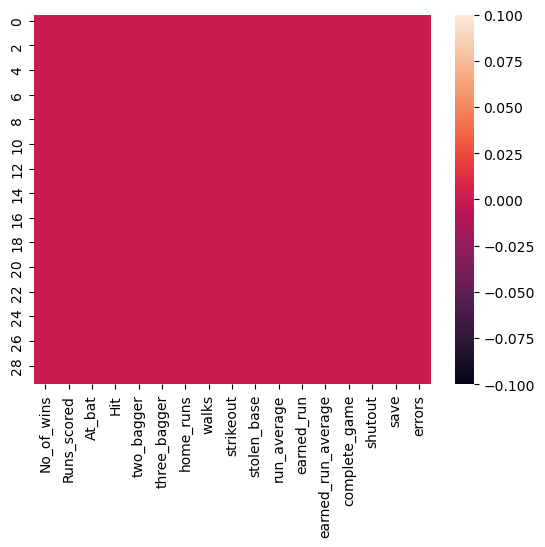

In [12]:
# lets visualization with heatmap for missing values
sns.heatmap(data.isnull())

here we see data does not have null values.

In [14]:
# check the frequency
for col in data.columns:
    print(data[col].value_counts())
    print('----------------------------------------')

No_of_wins
68     3
81     2
76     2
74     2
83     2
98     1
84     1
92     1
63     1
67     1
71     1
90     1
64     1
97     1
95     1
100    1
85     1
86     1
88     1
78     1
80     1
87     1
93     1
79     1
Name: count, dtype: int64
----------------------------------------
Runs_scored
689    2
696    2
724    1
647    1
650    1
720    1
667    1
626    1
573    1
613    1
703    1
683    1
640    1
655    1
697    1
694    1
656    1
661    1
729    1
751    1
748    1
644    1
713    1
764    1
891    1
622    1
669    1
737    1
Name: count, dtype: int64
----------------------------------------
At_bat
5485    2
5575    1
5631    1
5457    1
5649    1
5565    1
5385    1
5529    1
5420    1
5463    1
5428    1
5527    1
5571    1
5480    1
5491    1
5484    1
5467    1
5600    1
5544    1
5417    1
5459    1
5511    1
5640    1
5567    1
5509    1
5605    1
5533    1
5439    1
5572    1
Name: count, dtype: int64
----------------------------------------
Hit
1363   

##### Here we see all column is a continuous feature and my target label(No_of_wins) also a continuous then we can say that  its a regressor problem.

In [16]:
# check the information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   No_of_wins          30 non-null     int64  
 1   Runs_scored         30 non-null     int64  
 2   At_bat              30 non-null     int64  
 3   Hit                 30 non-null     int64  
 4   two_bagger          30 non-null     int64  
 5   three_bagger        30 non-null     int64  
 6   home_runs           30 non-null     int64  
 7   walks               30 non-null     int64  
 8   strikeout           30 non-null     int64  
 9   stolen_base         30 non-null     int64  
 10  run_average         30 non-null     int64  
 11  earned_run          30 non-null     int64  
 12  earned_run_average  30 non-null     float64
 13  complete_game       30 non-null     int64  
 14  shutout             30 non-null     int64  
 15  save                30 non-null     int64  
 16  errors    

# Statistics of dataset

In [17]:
# describe of data
data.describe()

,No_of_wins,Runs_scored,At_bat,Hit,two_bagger,three_bagger,home_runs,walks,strikeout,stolen_base,run_average,earned_run,earned_run_average,complete_game,shutout,save,errors
count,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,80.966667,688.233333,5516.266667,1403.533333,274.733333,31.300000,163.633333,469.100000,1248.20000,83.500000,688.233333,635.833333,3.956333,3.466667,11.300000,43.066667,94.333333
std,10.453455,58.761754,70.467372,57.140923,18.095405,10.452355,31.823309,57.053725,103.75947,22.815225,72.108005,70.140786,0.454089,2.763473,4.120177,7.869335,13.958889
min,63.000000,573.000000,5385.000000,1324.000000,236.000000,13.000000,100.000000,375.000000,973.00000,44.000000,525.000000,478.000000,2.940000,0.000000,4.000000,28.000000,75.000000
25%,74.000000,651.250000,5464.000000,1363.000000,262.250000,23.000000,140.250000,428.250000,1157.50000,69.000000,636.250000,587.250000,3.682500,1.000000,9.000000,37.250000,86.000000
50%,81.000000,689.000000,5510.000000,1382.500000,275.500000,31.000000,158.500000,473.000000,1261.50000,83.500000,695.500000,644.500000,4.025000,3.000000,12.000000,42.000000,91.000000
75%,87.750000,718.250000,5570.000000,1451.500000,288.750000,39.000000,177.000000,501.250000,1311.50000,96.500000,732.500000,679.250000,4.220000,5.750000,13.000000,46.750000,96.750000
max,100.000000,891.000000,5649.000000,1515.000000,308.000000,49.000000,232.000000,570.000000,1518.00000,134.000000,844.000000,799.000000,5.040000,11.000000,21.000000,62.000000,126.000000


    here we assume that all column have equal length.
    we see some columns(At_bat,Hit,home_runs,errors) have right skewness.
    and coolumns(walks,strikeout,run_average,earned_run) have some left skewness.
    we get huge difference with 75% and max in complete_game,run_average i.e have a outliers.

In [19]:
# transpose of describe data
data.describe().T

,count,mean,std,min,25%,50%,75%,max
No_of_wins,30.0,80.966667,10.453455,63.00,74.0000,81.000,87.75,100.00
Runs_scored,30.0,688.233333,58.761754,573.00,651.2500,689.000,718.25,891.00
At_bat,30.0,5516.266667,70.467372,5385.00,5464.0000,5510.000,5570.00,5649.00
Hit,30.0,1403.533333,57.140923,1324.00,1363.0000,1382.500,1451.50,1515.00
two_bagger,30.0,274.733333,18.095405,236.00,262.2500,275.500,288.75,308.00
three_bagger,30.0,31.300000,10.452355,13.00,23.0000,31.000,39.00,49.00
home_runs,30.0,163.633333,31.823309,100.00,140.2500,158.500,177.00,232.00
walks,30.0,469.100000,57.053725,375.00,428.2500,473.000,501.25,570.00
strikeout,30.0,1248.200000,103.759470,973.00,1157.5000,1261.500,1311.50,1518.00
stolen_base,30.0,83.500000,22.815225,44.00,69.0000,83.500,96.50,134.00


# Visualization (EDA)

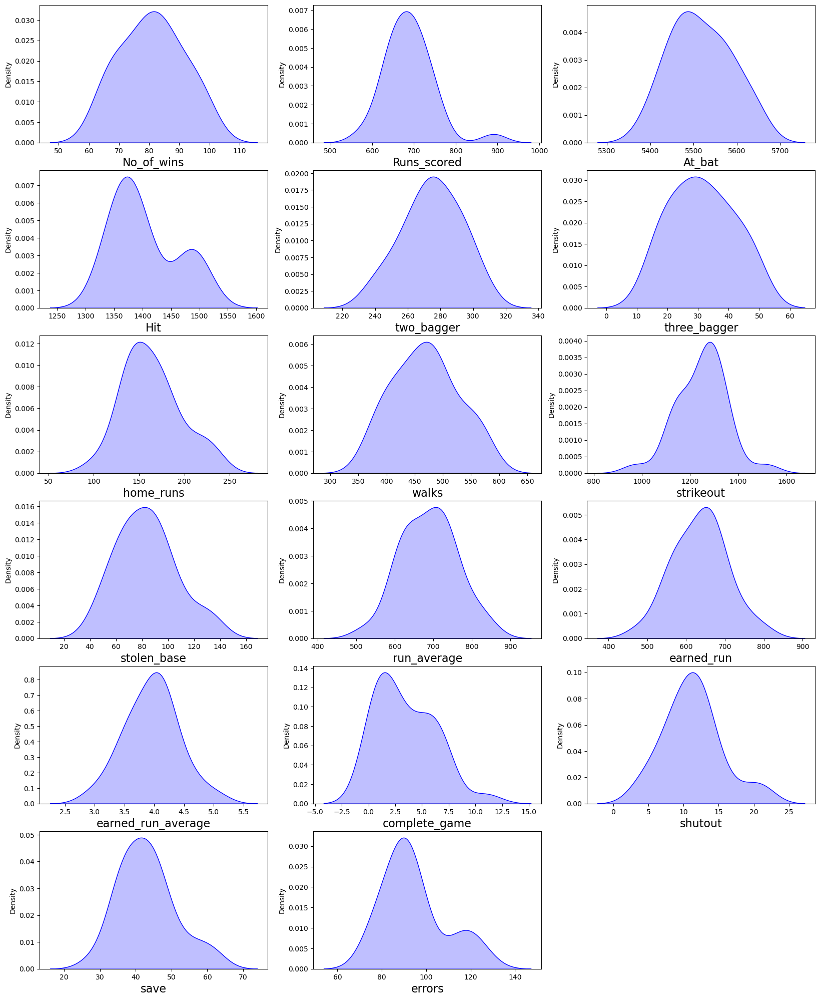

In [20]:
plt.figure(figsize=(20,25), facecolor='white')
col_no =1
for col in data:
    if col_no <=17:
        ax = plt.subplot(6,3,col_no)
        sns.kdeplot(data[col], color='b',shade=True)
        plt.xlabel(col,fontsize=16)
    col_no +=1
plt.show()

some of feature are either left or right skewed.

Text(0, 0.5, 'Hits')

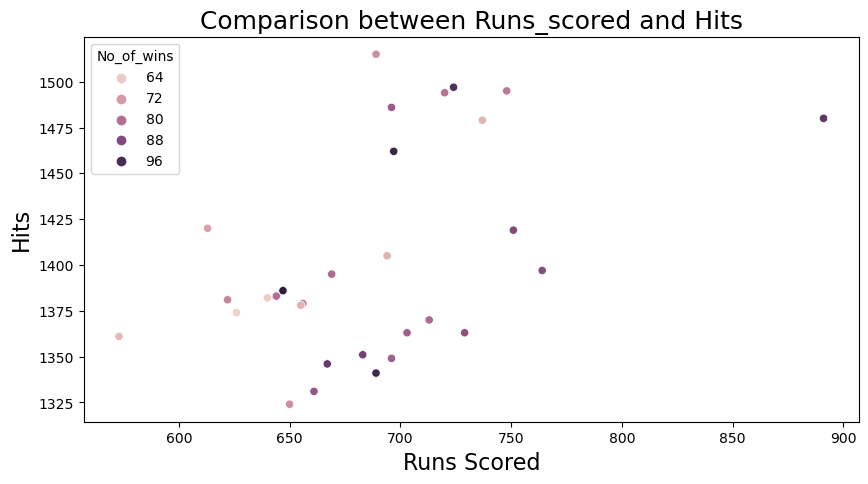

In [21]:
# Cheking the relationship b/w run_Score or hits
sns.set_palette('Set2')
plt.figure(figsize=[10,5])
plt.title('Comparison between Runs_scored and Hits',fontsize =18)
sns.scatterplot(x=data['Runs_scored'],y=data['Hit'],hue=data['No_of_wins'])
plt.xlabel('Runs Scored',fontsize =16)
plt.ylabel("Hits",fontsize =16)

######    Here we see:
    almost hits till 1375 and run scored b/w 650-750 to win the chance. and very less chance run scored less than 650 and hits less than 1325. 

Text(0, 0.5, 'At_bat')

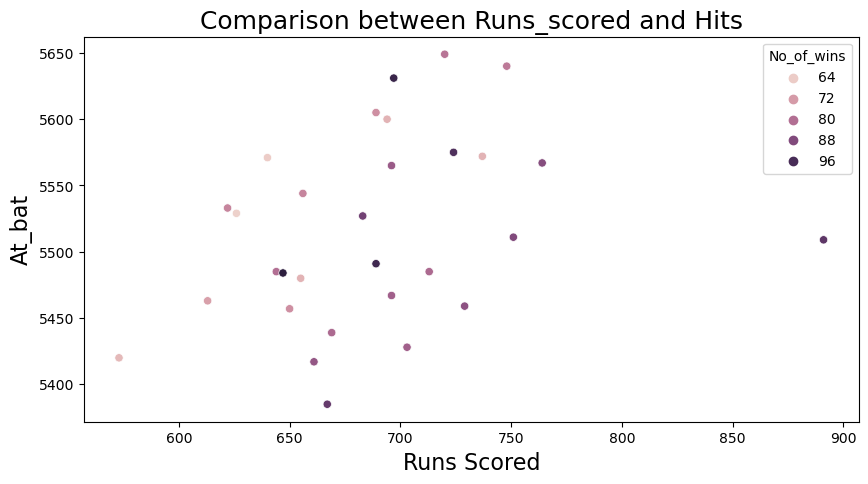

In [23]:
# relationship b/w Runs_score or At_bat
sns.set_palette('Set2')
plt.figure(figsize=[10,5])
plt.title('Comparison between Runs_scored and At_bat',fontsize =18)
sns.scatterplot(x=data['Runs_scored'],y=data['At_bat'],hue=data['No_of_wins'])
plt.xlabel('Runs Scored',fontsize =16)
plt.ylabel("At_bat",fontsize =16)

##### Boxplot of features

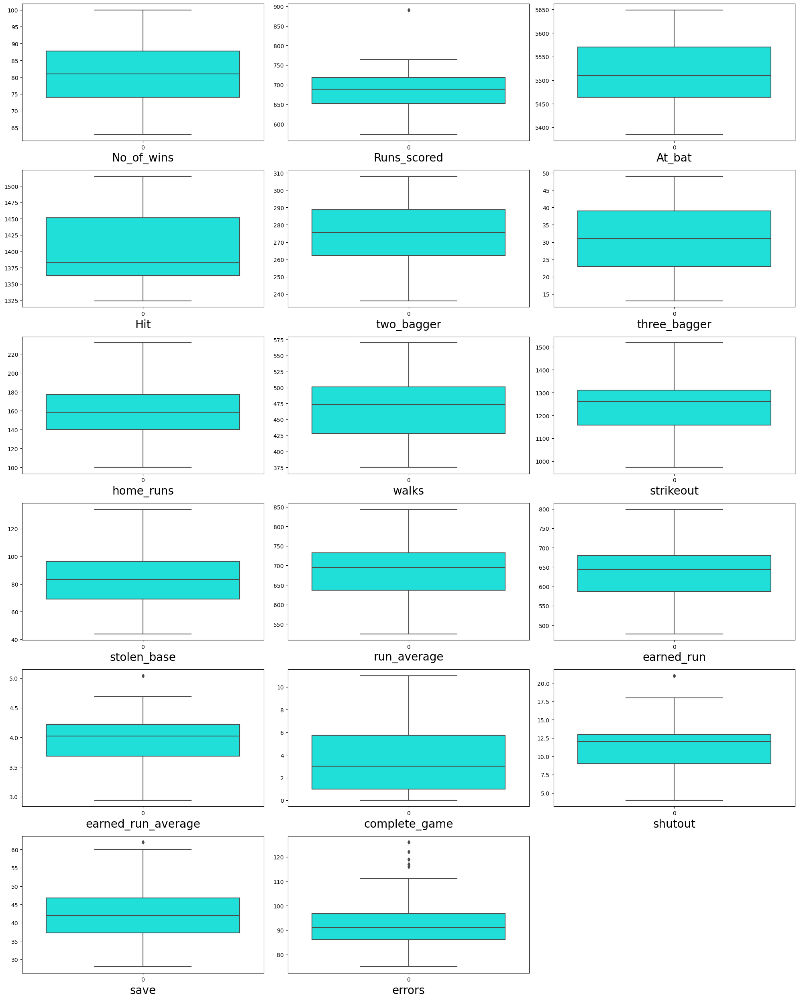

In [24]:
# Cheking the outliers with boxplot
plt.figure(figsize=(20,25), facecolor='white')
col_no =1
for col in data:
    if col_no <=18:
        ax = plt.subplot(6,3,col_no)
        sns.boxplot(data[col], palette='hsv')
        plt.xlabel(col,fontsize=20)
    col_no +=1
plt.tight_layout()
plt.show()


    There are some outliers present in data.
    Runs_scored,earned_run_average,shoutout,save and errors have outliers.

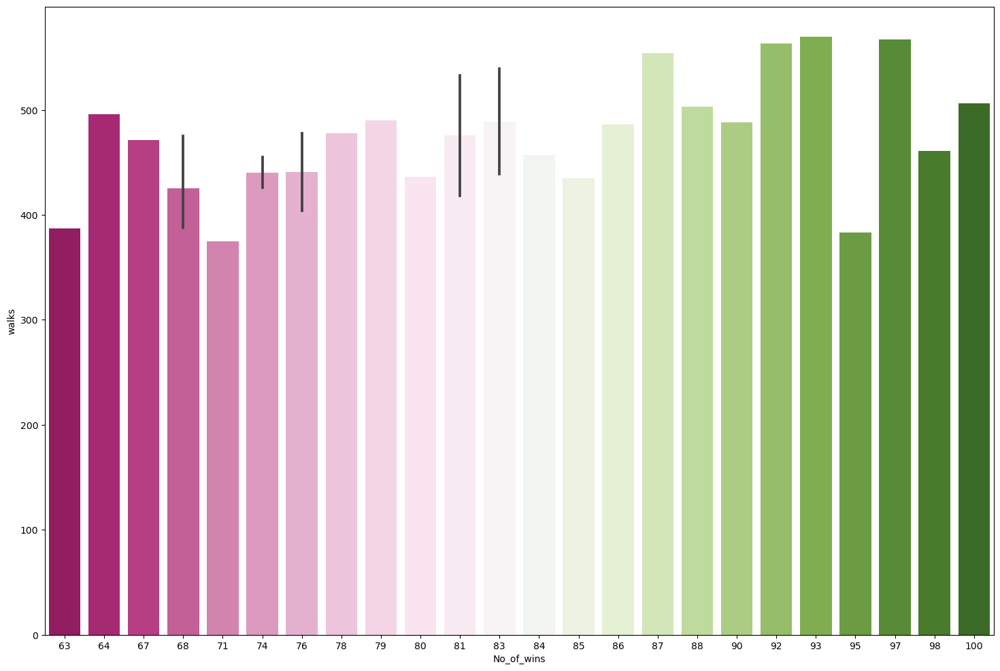

In [26]:
plt.figure(figsize=(18,12))
sns.barplot(x="No_of_wins", y="walks", data=data,palette='PiYG')
plt.show()

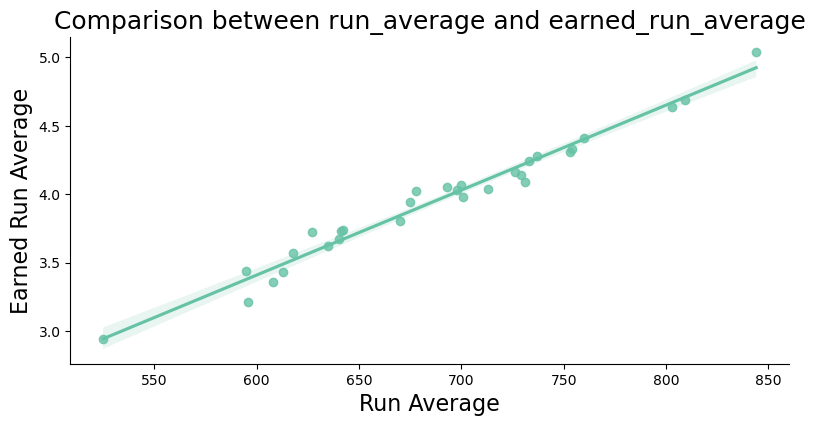

In [27]:
# relationship b/w two columns
sns.set_palette('Set2')
sns.lmplot(x='run_average', y='earned_run_average', data=data, height=4, aspect=2)
plt.title('Comparison between run_average and earned_run_average', fontsize=18)
plt.xlabel('Run Average', fontsize=16)
plt.ylabel("Earned Run Average", fontsize=16)
plt.show()

here we get the relation b/w run_average and earned_run_average is a linear relationship.

<Figure size 2500x10000 with 0 Axes>

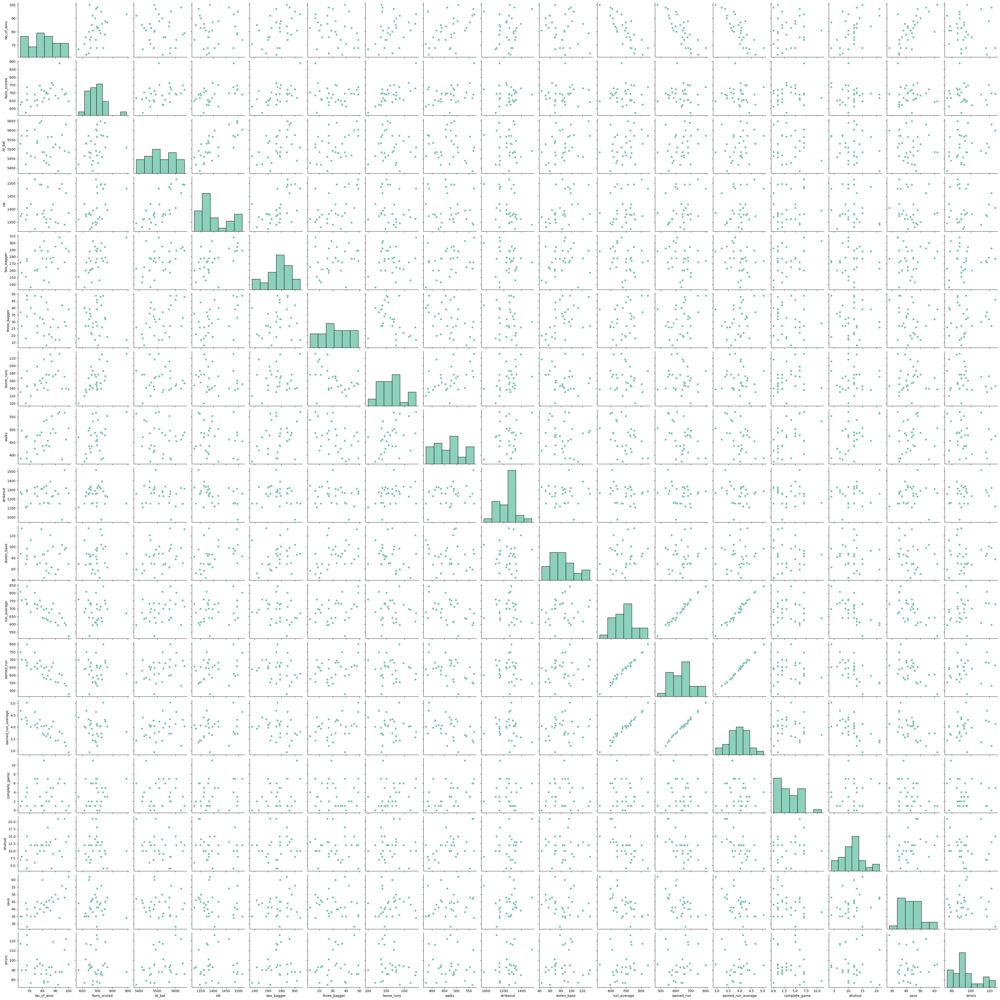

In [29]:
# check the relationship b/w all columns
plt.figure(figsize=(25,100))
sns.pairplot(data)
plt.show()

# Found the Outlier and remove

In [30]:
# Check the Z score
from scipy.stats import zscore
z = np.abs(zscore(data))
threshold = 3
df = data[(z<3).all(axis = 1)]

In [31]:
print(f'Shape of dataset after remove outlier : {df.shape}')

Shape of dataset after remove outlier : (29, 17)


In [32]:
# Check the loss data in percent
print('Percentage Data Loss : ',((data.shape[0]) - (df.shape[0])) * 100 /data.shape[0])

Percentage Data Loss :  3.3333333333333335


# Feature Selection : -

# 1 Check the skewness

In [33]:
# skewness of feature
cor=df.skew()

In [34]:
cor

No_of_wins            0.119013
Runs_scored          -0.215364
At_bat                0.169573
Hit                   0.783772
two_bagger           -0.335304
three_bagger          0.090124
home_runs             0.450862
walks                 0.151193
strikeout            -0.233815
stolen_base           0.494966
run_average           0.018155
earned_run            0.018461
earned_run_average    0.016693
complete_game         0.854980
shutout               0.526943
save                  0.627480
errors                0.840271
dtype: float64

    The skewness range is (-0.5 to 0.5) correct.
    but here we see Hit,complete_game,shutout,save,error have + skewness.

In [36]:
# Yeo-Johnson Transformation: Can handle both positive and negative values.
from sklearn.preprocessing import PowerTransformer

pt = PowerTransformer(method='yeo-johnson')
def rm_skew(col):
    df[col] = pt.fit_transform(df[[col]])
skew_column=['Hit','complete_game','shutout','save','errors']
for col in skew_column:
    rm_skew(col)


In [37]:
# Check the skewness after remove with Yeo-Johnson Transformation
df.skew()

No_of_wins            0.119013
Runs_scored          -0.215364
At_bat                0.169573
Hit                   0.000000
two_bagger           -0.335304
three_bagger          0.090124
home_runs             0.450862
walks                 0.151193
strikeout            -0.233815
stolen_base           0.494966
run_average           0.018155
earned_run            0.018461
earned_run_average    0.016693
complete_game        -0.045947
shutout               0.000529
save                 -0.000925
errors                0.065585
dtype: float64

# 2 Check Correlation

In [38]:
df.corr()

,No_of_wins,Runs_scored,At_bat,Hit,two_bagger,three_bagger,home_runs,walks,strikeout,stolen_base,run_average,earned_run,earned_run_average,complete_game,shutout,save,errors
No_of_wins,1.000000,0.390451,-0.085780,-0.020540,0.384886,-0.206737,0.245697,0.447513,0.156469,-0.169503,-0.823176,-0.815308,-0.826952,0.007696,0.481626,0.756713,-0.079633
Runs_scored,0.390451,1.000000,0.438022,0.435073,0.469293,0.134204,0.586894,0.258450,0.081158,0.075323,-0.013858,0.007727,-0.009122,0.155122,-0.113640,0.083261,0.039865
At_bat,-0.085780,0.438022,1.000000,0.773622,0.490752,0.445604,-0.064653,-0.137850,-0.111243,0.373674,0.315499,0.309146,0.254872,-0.059648,-0.194219,-0.147964,0.332002
Hit,-0.020540,0.435073,0.773622,1.000000,0.530144,0.566793,-0.221813,-0.209681,-0.380109,0.430001,0.229856,0.265399,0.241519,0.064183,-0.132921,-0.113963,0.001090
two_bagger,0.384886,0.469293,0.490752,0.530144,1.000000,0.342419,-0.098695,0.211243,-0.096772,0.194308,-0.215196,-0.224993,-0.248212,0.227220,0.088226,0.241326,0.152541
three_bagger,-0.206737,0.134204,0.445604,0.566793,0.342419,1.000000,-0.369299,-0.404852,-0.196586,0.483818,0.312750,0.333731,0.325883,-0.004496,-0.066384,-0.269255,0.080498
home_runs,0.245697,0.586894,-0.064653,-0.221813,-0.098695,-0.369299,1.000000,0.336814,0.479914,-0.166072,-0.092586,-0.062094,-0.070756,0.118284,-0.024448,0.106523,-0.165883
walks,0.447513,0.258450,-0.137850,-0.209681,0.211243,-0.404852,0.336814,1.000000,0.315566,-0.117622,-0.425381,-0.455832,-0.465794,0.445335,0.441043,0.207948,-0.056106
strikeout,0.156469,0.081158,-0.111243,-0.380109,-0.096772,-0.196586,0.479914,0.315566,1.000000,0.038188,-0.140570,-0.177655,-0.195362,-0.063129,0.204704,0.125572,0.164817
stolen_base,-0.169503,0.075323,0.373674,0.430001,0.194308,0.483818,-0.166072,-0.117622,0.038188,1.000000,0.134315,0.146243,0.128848,-0.040524,-0.100054,-0.195772,0.070527


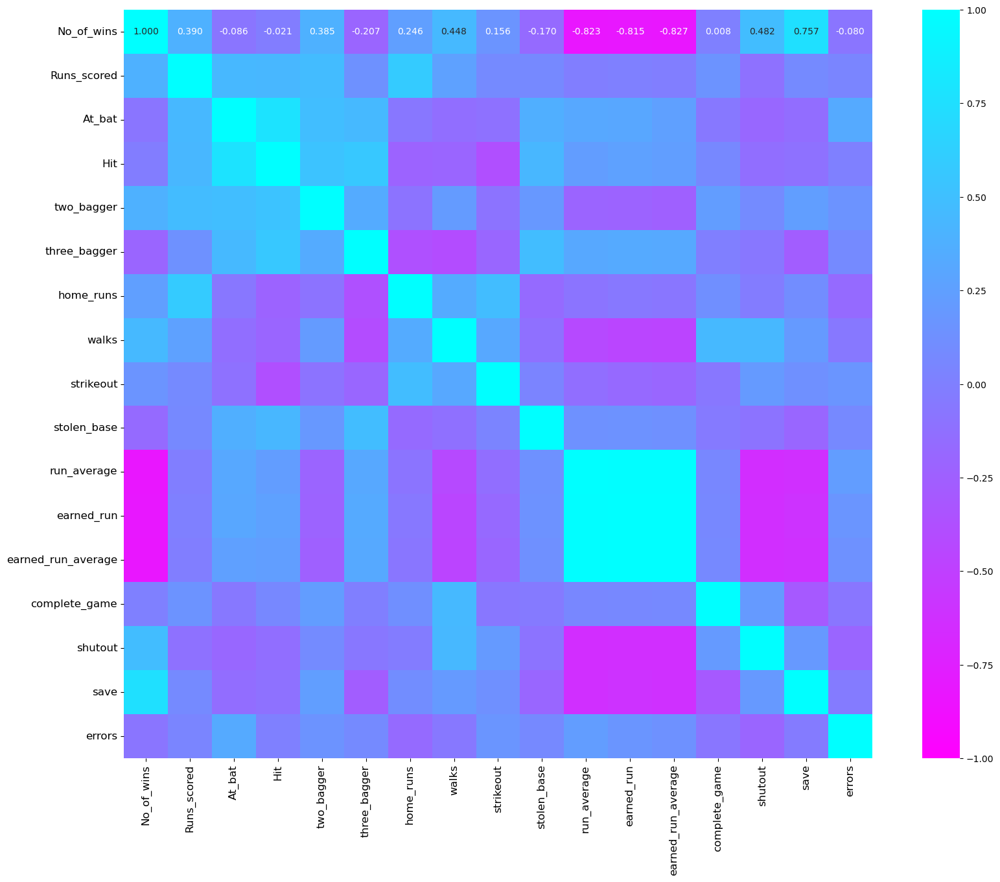

In [39]:
# Visualize the correlation with heatmap
# sns.heatmap(df.corr()
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':10}, cmap="cool_r")
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

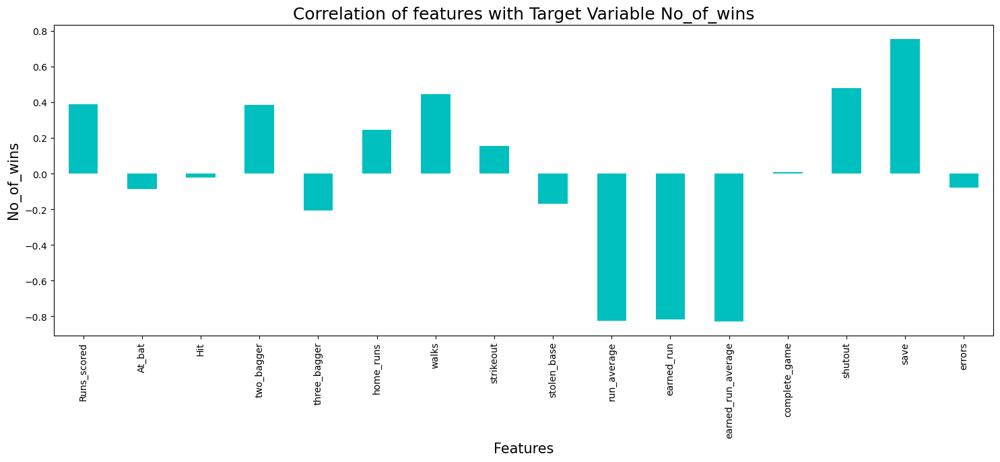

In [40]:
plt.figure(figsize = (18,6))
df.corr()['No_of_wins'].drop(['No_of_wins']).plot(kind='bar',color = 'c')
plt.xlabel('Features',fontsize=15)
plt.ylabel('No_of_wins',fontsize=15)
plt.title('Correlation of features with Target Variable No_of_wins',fontsize = 18)
plt.show()

##### Comment :
    Hits, At bats, Complete game and errors are very poorly correlated with target variable.
    Saves, ERA,RA,EA are highly correleated with target variable.
    here is visible multi colinearity between the feature columns "Earned Runs", "Earned Run Average" and "Runs Average". This need to check.

# Separate Feature and label


In [41]:
X=df.drop(['No_of_wins'],axis=1)

In [42]:
Y=df['No_of_wins']

In [43]:
print(f'Shape of X data : {X.shape}')
print(f'Shape of Y data : {Y.shape}')

Shape of X data : (29, 16)
Shape of Y data : (29,)


# Using StandardScalar


In [44]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X=pd.DataFrame(sc.fit_transform(X),columns=X.columns)
X

,Runs_scored,At_bat,Hit,two_bagger,three_bagger,home_runs,walks,strikeout,stolen_base,run_average,earned_run,earned_run_average,complete_game,shutout,save,errors
0,0.959398,0.830084,1.659631,1.556538,1.010845,-0.765863,-1.536359,-2.727623,0.905953,-0.664514,-0.511148,-0.511388,-0.307098,-0.787002,1.532753,-0.348265
1,0.331147,-0.702831,-0.959651,0.201171,1.208917,-0.181389,-0.495021,0.121896,-0.585315,0.154638,0.232161,0.238952,-0.307098,0.236737,0.312020,-0.540820
2,-0.274666,-1.100253,0.022580,1.733325,-0.276617,-0.697101,1.252941,-0.925866,0.116458,-0.678397,-0.754153,-0.643801,2.011315,-0.252844,-0.664137,-1.326125
3,-1.329231,0.233951,-0.304830,-0.800621,-0.474688,-0.869006,-1.145857,-0.201246,-0.673037,0.168522,0.089217,0.040333,1.264463,-0.513555,-0.820689,0.650818
4,0.174084,1.255894,1.877905,0.908319,1.704094,-0.353293,-0.197495,0.072935,-0.015124,1.584683,1.561540,1.496876,1.264463,0.236737,-1.149165,-0.540820
5,1.856900,0.716535,0.022580,-0.093474,-1.266972,1.743939,1.643442,-0.240414,-0.892341,0.126870,0.217866,0.150677,0.121871,-2.064039,0.677176,0.082858
6,0.712585,-0.447345,-0.523104,-1.625627,-1.167936,1.915843,-0.885522,0.777970,-1.725697,0.057451,0.132100,0.194815,-1.732896,-0.252844,0.052325,-1.588197
7,-0.835605,-0.447345,-0.304830,0.260100,0.020490,0.196801,-0.550807,0.572335,0.160319,-0.650630,-0.468265,-0.489319,-0.870682,0.236737,1.908137,0.237592
8,1.497899,1.752672,1.659631,1.202964,0.119526,-0.009484,0.230197,-1.013995,-0.541454,0.890486,0.818231,0.768604,0.121871,-0.252844,-0.365006,0.383386
9,1.565212,-0.078310,0.459127,0.319029,0.020490,0.368705,0.695081,-0.181661,0.774370,0.612808,0.618110,0.614123,0.770649,-0.513555,0.312020,1.554265


### 3. Checking Multicollinearity between features using variance_inflation_factor

In [45]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"]=X.columns
vif

,VIF values,Features
0,7.059941,Runs_scored
1,19.091779,At_bat
2,9.223315,Hit
3,3.522895,two_bagger
4,3.248340,three_bagger
5,8.747999,home_runs
6,3.262066,walks
7,2.805414,strikeout
8,1.947138,stolen_base
9,206.823330,run_average


##### Comment :
    It is natural to have such high multicollinearity due to following reason :-
    Earned Run Average,Earned Runs,Runs Average are highly correlated with each other.
    At Bat and Hits are 0.771 correlated with each other. But at same time very poor correlated with target variable.
    Another most important reason is data need to scale which we did not scale until now.
    Strategy to Address Multicollinearity :
    Removing Some of highly correlated features. But this will not work here as most of input features are correlated with each other either moderated or poorly.
    Another way to address Multicollinerity is to Scaled Data and then apply PCA.
    We will go by Second way for further investigation.

### 4. PCA

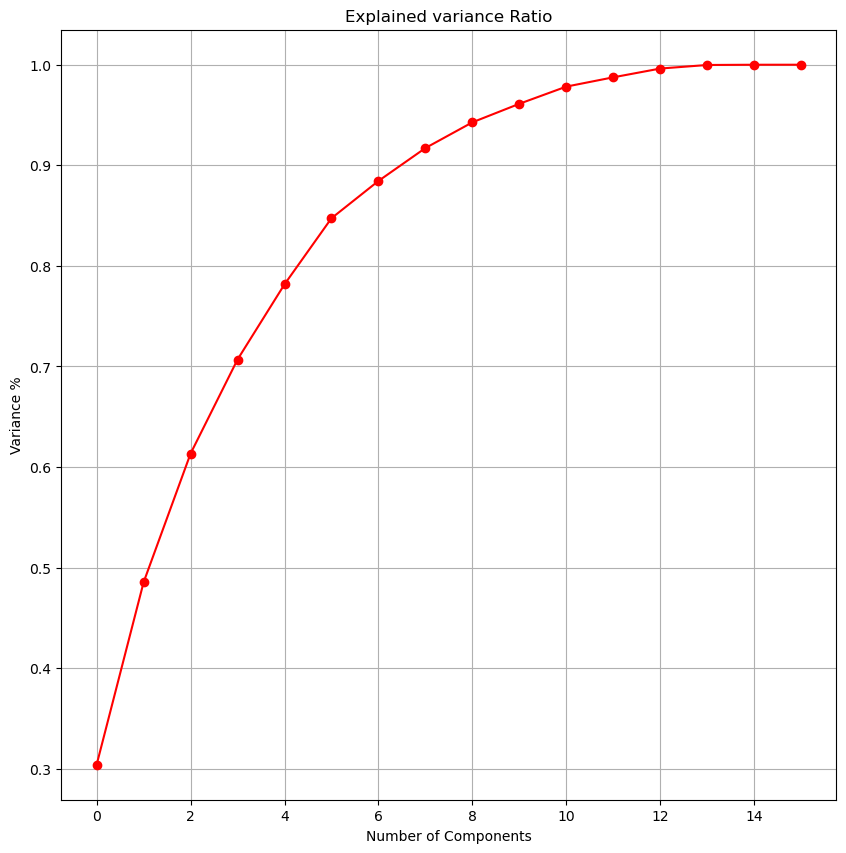

In [46]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x = pca.fit_transform(X)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

here we see the most distribution variance in 12 feature so we can apply only 12 feature rest can drop the feature.

In [48]:
pca_x = PCA(n_components=12)
x = pca_x.fit_transform(x)

In [49]:
rm_pca=pd.DataFrame(x,columns=np.arange(12))

# Check VIF after PCA

In [50]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF']= [variance_inflation_factor(rm_pca.values,i) for i in range(rm_pca.shape[1])]
vif['Features']= rm_pca.columns
vif

,VIF,Features
0,1.0,0
1,1.0,1
2,1.0,2
3,1.0,3
4,1.0,4
5,1.0,5
6,1.0,6
7,1.0,7
8,1.0,8
9,1.0,9


We can observe the Multicollinearity issue has cleared.

# Model Building

In [52]:
# !pip install xgboost
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor,GradientBoostingRegressor,RandomForestRegressor,BaggingRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor

# Find the best random state

In [53]:
#  finding the best Random State for Linear Regression
max_cost_accuracy=0
random_state_max=0
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(rm_pca,Y,test_size=0.25,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    pred_accuracy=r2_score(y_test,pred)
    if(max_cost_accuracy<pred_accuracy):
        max_cost_accuracy=pred_accuracy
        random_state_max=i

print(f"Maximum r2 score is {max_cost_accuracy} on Random_state {random_state_max} ")

Maximum r2 score is 0.9521172863008462 on Random_state 75 


# Check Evaluation

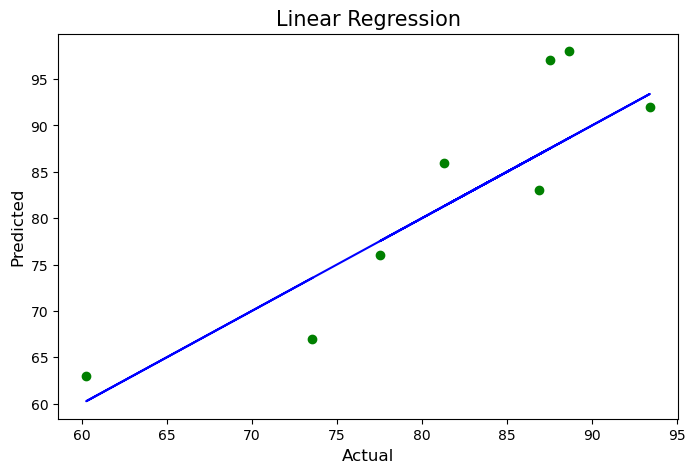

In [54]:
plt.figure(figsize=(8,5))
lr=LinearRegression()
lr.fit(x_train,y_train)
predict=lr.predict(x_test)
plt.scatter(x=predict,y=y_test,color='g')
plt.plot(predict,predict,color='b')
plt.xlabel("Actual",fontsize=12)
plt.ylabel("Predicted",fontsize=12)
plt.title("Linear Regression",fontsize=15)
plt.show()

In [55]:
#  finding the best Random State for RandomForest Regressor
max_cost_accuracy=0
random_state_max=0
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(rm_pca,Y,test_size=0.25,random_state=i)
    rfr=RandomForestRegressor()
    rfr.fit(x_train,y_train)
    pred=rfr.predict(x_test)
    pred_accuracy=r2_score(y_test,pred)
    if(max_cost_accuracy<pred_accuracy):
        max_cost_accuracy=pred_accuracy
        random_state_max=i

print(f"Maximum r2 score is {max_cost_accuracy} on Random_state {random_state_max} ")

Maximum r2 score is 0.6224076407506701 on Random_state 56 


here we see the best r2 score in LinearReggression at 75 Random_State.

In [57]:
x_train,x_test,y_train,y_test=train_test_split(rm_pca,Y,test_size=0.25,random_state=75)

# Check on the other model

In [58]:
from sklearn.model_selection import cross_val_score
all_model=[LinearRegression,RandomForestRegressor,GradientBoostingRegressor,AdaBoostRegressor,BaggingRegressor,DecisionTreeRegressor,KNN,Lasso,Ridge,SVR,XGBRegressor]
for model in all_model:
    obj=model()
    obj.fit(x_train,y_train)
    predict=obj.predict(x_test)
    pred_train= obj.predict(x_train)
    print(f"-------------Accuracy with {str (model)}-----------------")
    print("Accuracy :",r2_score(y_test,predict))
    print("Acuracy on trained data :",r2_score(y_train,pred_train)*100)
    print(f'print the mean absolute error : {mean_absolute_error(y_test,predict)}')
    print(f'print the mean squared error : {mean_squared_error(y_test,predict)}')
    print(f'print the root mean squared error : {np.sqrt(mean_squared_error(y_test,predict))}')
    print()
    
    print(f"*******Check the validation Score***********")
    score=cross_val_score(obj,X,Y)
    print(score)
    print('Cross Validation score : ',score.mean())
    print(f"Difference between Accuracy score and cross validation score is : {r2_score(y_test,predict)-score.mean()}")
    print()

-------------Accuracy with <class 'sklearn.linear_model._base.LinearRegression'>-----------------
Accuracy : 0.9521172863008462
Acuracy on trained data : 89.97806140785988
print the mean absolute error : 2.188041620740652
print the mean squared error : 5.643426709886201
print the root mean squared error : 2.375589760435543

*******Check the validation Score***********
[ 0.65779784 -0.33103016  0.58632994 -0.11488692 -0.34912821]
Cross Validation score :  0.08981649775939157
Difference between Accuracy score and cross validation score is : 0.8623007885414546

-------------Accuracy with <class 'sklearn.ensemble._forest.RandomForestRegressor'>-----------------
Accuracy : 0.4026038446241549
Acuracy on trained data : 87.48299365470214
print the mean absolute error : 7.528749999999999
print the mean squared error : 70.4087375
print the root mean squared error : 8.390991449167375

*******Check the validation Score***********
[ 0.09964682 -5.13639474  0.44527478  0.3851682   0.88085436]
Cross 



 True Values Vs Predicted Value plot with Ridge 


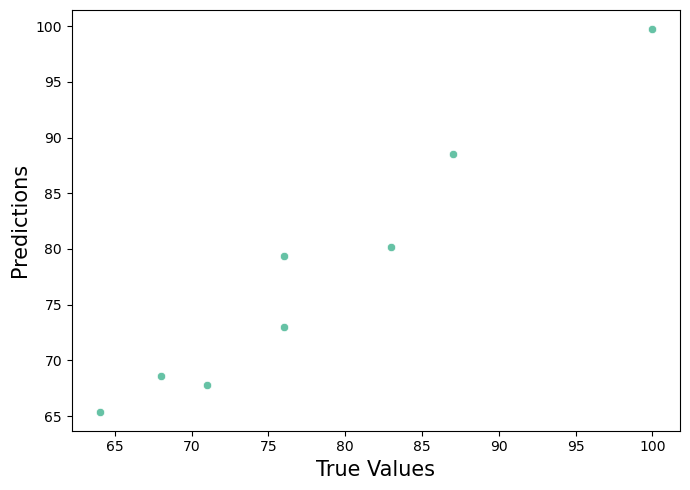

In [67]:
plt.figure(figsize=(7,5))
rg=Ridge()
rg.fit(x_train,y_train)
y_pred=rg.predict(x_test)
print('\n')
print('\033[1m' + ' True Values Vs Predicted Value plot with Ridge ' + '\033[0m')
sns.scatterplot(x=y_test.round(2), y=y_pred)
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.tight_layout()
plt.show()
print('\n')

    we can see that Ridge Regression gives maximum R2 score of 95.40%. 
    So we will apply Hyperparameter tuning on Ridge Regression.

# Hyper Parameter Tuning : GridSearchCV

In [68]:
from sklearn.model_selection import GridSearchCV

In [69]:
parameter = {
            'alpha':[1,0.5,0.1,0.01,0.001,0.0001],
            'fit_intercept': [True,False],
            'max_iter':[100,200,400,1000,1500],
            'random_state':np.arange(100),
            'solver' : ['auto', 'svd', 'cholesky', 'lsqr','sag','lbfgs']
            }

In [71]:
gcv = GridSearchCV(Ridge(),parameter,cv=5,verbose = 4)
gcv.fit(x_train,y_train)

Fitting 5 folds for each of 36000 candidates, totalling 180000 fits
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=0, solver=svd;, score=0.239 total time=   0.0s

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=3, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=6, 

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=10, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_s

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.506 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.240 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=21, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, rando

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=25, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, rand

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, ran

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=33, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, rando

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, ran

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=44, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, r

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=48, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=48, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=48, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=48, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=48, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, ran

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=55, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, rand

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=62, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, rando

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_ite

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=sag;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=sag;, score=0.506 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=76, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, rando

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=79, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, ran

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=83, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=T

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, rando

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=93, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_ite

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=100, random_state=97, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100, random_

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=1, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=1,

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=4, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, r

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=6

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=10, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_ite

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=Tr

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=18, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, r

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, ran

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, ma

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=32, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_ite

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, rand

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_s

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=43, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, ma

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=47, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, ma

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=50, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, rando

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_s

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=59, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=62, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=Tru

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=71, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, rando

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_s

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=79, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_s

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=87, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_ite

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, ran

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=95, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=200, random_state=98, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_ite

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=sag;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=2, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_stat

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=15, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=15, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=15, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, rando

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=23, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_s

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=T

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=33, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=Tr

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=37, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, ma

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=41, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=41, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_s

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=48, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=T

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=54, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, ran

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=0.504 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=0.240 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, rando

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=60, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, ran

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=sag;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_s

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=71, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, r

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=78, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_ite

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=40

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, ran

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_s

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, rand

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=97, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=97, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=97, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=97, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=400, random_state=97, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=400, ran

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=0, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, ma

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=7, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=Tru

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000,

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=18, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True,

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=22, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000,

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000,

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=36, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_int

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.165 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True,

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=56, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=56, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=60, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=60, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=100

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=100

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=67, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000,

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=79, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=83, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=sag;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=86, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=90, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=10

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1000,

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, ran

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, ma

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, ma

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500,

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_in

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=sag;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=19, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.240 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=28, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True,

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.240 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.221 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=35, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=37, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_int

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=40, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_int

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=44, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=44, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=150

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=47, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500,

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=auto;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.162 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=0.504 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=60, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=60, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=60, solver=auto;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=60, solver=auto;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.164 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500,

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=67, solver=lsqr;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_inte

[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=77, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_inter

[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=svd;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=svd;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=81, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True,

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=svd;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=svd;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=svd;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=cholesky;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=cholesky;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=cholesky;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=cholesky;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=88, solver=cholesky;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_inter

[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=lsqr;, score=0.239 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.219 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=15

[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=0.247 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=0.505 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=0.238 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=0.220 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=150

[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=sag;, score=0.248 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=0.503 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=0.163 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=True, max_iter=150

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=sag;, score=-415.458 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=sag;, score=-501.945 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=sag;, score=-574.407 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=sag;, score=-454.971 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=sag;, score=-157.573 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=sag;, score=-415.494 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=sag;, score=-501.750 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=5, solver=sag;, score=-574.379 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=9, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END al

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-415.476 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-501.701 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-574.361 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=26, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=34, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=34, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=34, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=34, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=34, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=37, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-415.510 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-501.625 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-574.385 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=sag;, score=-157.570 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, ma

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=48, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=52, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=56, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-415.451 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-501.634 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-574.375 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-454.853 total time=   0.0s
[CV 5/5] END alpha=1, fit_in

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=62, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=67, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=71, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-454.752 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-157.605 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=74, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=77, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=sag;, score=-157.566 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=85, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=85, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, ma

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-415.469 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-501.783 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-574.472 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-454.779 total time=   0.0s
[CV 5/5] END alpha=1, fit_in

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_in

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-415.504 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-501.740 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-574.345 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-454.877 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-157.575 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_interce

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=sag;, score=-415.507 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=sag;, score=-502.037 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=sag;, score=-574.376 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=sag;, score=-454.857 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=100, random_state=98, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_int

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=2, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END al

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=sag;, score=-454.855 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=6, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=20

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=sag;, score=-415.560 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=sag;, score=-501.600 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=sag;, score=-574.407 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=sag;, score=-454.752 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=13, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_int

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=sag;, score=-415.562 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=sag;, score=-502.005 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=19, solver=sag;, score=-574.392 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=23, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=27, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=sag;, score=-415.621 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=sag;, score=-501.629 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=sag;, score=-574.424 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=sag;, score=-454.840 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=F

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=34, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=sag;, score=-415.477 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=sag;, score=-501.763 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=38, solver=sag;, score=-574.401 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=42, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=sag;, score=-454.830 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=46, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=56, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=56, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=56, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=56, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=56, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=63, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-415.474 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-501.838 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-574.390 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-454.842 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-157.594 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-415.536 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-501.666 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-574.344 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-454.825 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-157.575 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_interce

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=sag;, score=-454.859 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=79, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=82, solver=sag;, score=-415.553 total time=   0.0s
[CV 2/5] END alph

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=sag;, score=-415.551 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=sag;, score=-501.749 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=sag;, score=-574.332 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=sag;, score=-454.781 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=sag;, score=-157.585 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=90, solver=sag;, score=-415.526 total time=   0.0s
[CV 2/5] END alph

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=94, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1,

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=sag;, score=-157.573 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=4

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-415.548 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-501.750 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-574.379 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-454.855 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-415.560 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-501.600 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-574.407 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-454.752 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=13, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-415.526 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-501.701 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-574.361 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=21, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=24, solver=sag;, score=-415.515 total time=   0.0s
[CV 2/5] END alph

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=28, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=sag;, score=-415.621 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=sag;, score=-501.629 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=sag;, score=-574.424 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=sag;, score=-454.840 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_interce

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=35, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-454.865 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-157.578 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=38, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-415.605 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-501.625 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-574.385 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=sag;, score=-415.542 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=44, solver=sag;, score=-501.651 total time=   0.0s
[CV 3/5] END alpha=1, 

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_in

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=sag;, score=-501.571 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=sag;, score=-574.381 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=sag;, score=-454.830 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, m

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=sag;, score=-415.602 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=sag;, score=-501.632 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=54, solver=sag;, score=-574.403 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-415.451 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-501.634 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-574.375 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-454.853 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=sag;, score=-415.499 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=sag;, score=-501.577 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=sag;, score=-574.365 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=62, solver=sag;, score=-454.763 total time=   0.0s
[CV 5/5] END alpha=1, fit_in

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=66, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5]

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-415.572 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-501.640 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-574.364 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-454.844 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=F

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-415.573 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-501.627 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-574.413 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-415.563 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-501.580 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-574.339 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-454.816 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=sag;, score=-415.502 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=sag;, score=-501.666 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=sag;, score=-574.376 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=sag;, score=-454.731 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=sag;, score=-157.575 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=83, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=sag;, score=-415.551 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=sag;, score=-501.749 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=sag;, score=-574.332 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=sag;, score=-454.781 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=sag;, score=-157.585 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=90, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=sag;, score=-415.530 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=sag;, score=-501.694 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=sag;, score=-574.340 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=sag;, score=-454.869 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=sag;, score=-574.402 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=sag;, score=-454.793 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=sag;, score=-415.587 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=sag;, score=-502.000 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=0, solver=sag;, score=-574.369 total time=   0.0s
[CV 4/5] END alpha=1, fit_i

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=sag;, score=-415.514 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=sag;, score=-501.626 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=sag;, score=-574.400 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=sag;, score=-454.782 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-454.849 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=11, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alph

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=15, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END 

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-454.809 total time=   0.0s


[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=20, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END 

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1,

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=sag;, score=-415.551 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=sag;, score=-502.108 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=sag;, score=-574.333 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=sag;, score=-454.836 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=sag;, score=-157.579 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_interce

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=31, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=31, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=31, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=33, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alph

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=41, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=sag;, score=-415.404 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=sag;, score=-501.594 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=sag;, score=-574.444 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=sag;, score=-454.807 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=43, solver=sag;, score=-157.578 total time=   0.0s
[CV 1/5] END alpha=1,

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=47, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1,

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=sag;, score=-574.386 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=sag;, score=-454.810 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=sag;, score=-157.578 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=Fal

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=lsqr;, score=-157.604 total time=   0.2s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=sag;, score=-415.415 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=53, solver=sag;, score=-501.603 total time=   0.0s
[CV 3/5] END a

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-415.536 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-501.629 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-574.330 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-454.770 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-157.575 total time=   0.0s
[CV 1/5] END alpha=1,

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=60, solver=lsqr;, score=-501.855 total time=   0.

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-501.661 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-574.448 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-454.804 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=67, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] 

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=sag;, score=-454.825 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=sag;, score=-157.575 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=Fa

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-415.541 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-501.622 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-574.427 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-454.775 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-157.577 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_int

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=79, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=79, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=79, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=83, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=83, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=83, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=87, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=87, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=87, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=87, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_interc

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-501.674 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-574.371 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-454.877 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-157.578 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=93, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=sag;, score=-415.548 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=95, solver=sag;, score=-501.583 total time=   0.0s
[CV 3/5] END a

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] 

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=sag;, score=-574.404 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=sag;, score=-454.745 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=sag;, score=-415.496 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=sag;, score=-501.600 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=sag;, score=-574.377 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=sag;, score=-454.814 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=sag;, score=-157.629 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=F

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=11, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=11, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=11, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=11, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_interc

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-157.604 total time=   0.0s

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=17, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] 

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_interc

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=sag;, score=-454.825 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=sag;, score=-157.572 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=29, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=Fa

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=sag;, score=-415.502 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=sag;, score=-501.641 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=sag;, score=-574.376 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=32, solver=sag;, score=-454.845 total time=   0.0s
[CV 5/5] END alpha=1

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=35, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=35, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=F

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-415.532 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-501.979 total time=   0.0s
[CV 3/5] END a

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=sag;, score=-501.628 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=sag;, score=-574.385 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=sag;, score=-454.832 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=sag;, score=-157.573 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=42, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=sag;, score=-415.486 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=45, solver=sag;, score=-501.616 total time=   0.0s
[CV 3/5] END a

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-415.559 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-501.813 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-574.386 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-454.810 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-157.578 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_interce

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=sag;, score=-574.399 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=sag;, score=-454.802 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=sag;, score=-157.576 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=Fal

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=56, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] 

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=60, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=60, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=60, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=

[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=auto;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=63, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, 

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=68, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] 

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-416.002 total time=   0.0

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-415.541 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-501.622 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-574.427 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-454.775 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-157.577 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=sag;, score=-574.447 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=sag;, score=-454.859 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=Fal

[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-415.553 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-501.597 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-574.385 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-454.810 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-157.574 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=1, fit_interce

[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=85, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alph

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=svd;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=cholesky;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=89, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 

[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=lsqr;, score=-454.809 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=92, solver=lsqr;, score=-157.604 total time=   0.0s
[CV 

[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=cholesky;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=cholesky;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=cholesky;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=cholesky;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-501.855 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-454.809 total time=   0.0s


[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=auto;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=auto;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=auto;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=auto;, score=-157.604 total time=   0.0s
[CV 1/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-416.002 total time=   0.0s
[CV 2/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-501.822 total time=   0.0s
[CV 3/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-574.742 total time=   0.0s
[CV 4/5] END alpha=1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-454.811 total time=   0.0s
[CV 5/5] END alpha=1

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=3, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_ite

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=sag;, score=0.332 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=5, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_ite

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=8, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=8, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=0.332 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=sag;, score=0.332 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=15, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=sag;, score=0.048 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=20, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=sag;, score=0.200 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=sag;, score=0.048 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=0.048 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=28, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=32, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=32, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=32, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=32, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=36, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=0.331 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=0.085 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=43, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.335 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=sag;, score=0.331 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=sag;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=sag;, score=0.048 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.320 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.202 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.331 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=63, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=66, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5,

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=69, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=73, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=73, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=73, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, m

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=76, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.328 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.198 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=83, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=Tru

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=86, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.198 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.332 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.049 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=98, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=98, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=98, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=100, random_state=98, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=2, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=6, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=9, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_i

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=13, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True,

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=16, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=24, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.125 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5,

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=sag;, score=0.124 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=40, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=44, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True,

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=55, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=62, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True,

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=66, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=66, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, ma

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=73, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=76, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=80, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5,

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, m

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=88, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=88, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, ma

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=95, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=95, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=95, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=95, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=200, random_state=98, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=1, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_ite

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=5, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=5, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=5, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=7, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=10, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=14, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_inter

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=18, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=22, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=22, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=24, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=28, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.202 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=36, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=36, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, ma

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=40, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True,

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=0.124 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, 

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=51, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=54, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, m

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=61, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=65, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=0.046 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=80, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=83, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=83, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=83, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, m

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=86, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_inter

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=400, random_state=97, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, m

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=2, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=2, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, ma

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=4, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_inter

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=8, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True,

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=Tr

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=15, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=sag;, score=0.129 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=26, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_interce

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=28, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END 

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=sag;, score=0.202 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=30, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=34, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alp

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=Tr

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=41, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END a

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=Tr

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=47, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END al

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=54, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=59, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=59, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=59, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=59, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=sag;, score=0.129 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=64, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_inter

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=Tr

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=74, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_interce

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=Tr

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=sag;, score=0.202 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=sag;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=Tr

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=85, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=89, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END 

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=96, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_i

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, f

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=sag;, score=0.200 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=6, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=14, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END al

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=18, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=21, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END a

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.200 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=Tr

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=28, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=32, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=sag;, score=0.124 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=T

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_inter

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=50, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_interce

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=0.081 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=sag;, score=0.082 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=sag;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=64, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=67, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END a

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=71, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=lsqr;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=lsqr;, score=0.080 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=lsqr;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=lsqr;, score=0.127 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=lsqr;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=75, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, f

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=0.045 total time=   0.0s
[CV 1/5] END al

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=svd;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=svd;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=svd;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=cholesky;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=cholesky;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=cholesky;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=82, solver=cholesky;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0

[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=sag;, score=0.128 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=Tr

[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=0.045 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_interce

[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=0.302 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=0.083 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=0.201 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercep

[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.084 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.199 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.126 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.047 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=Tr

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-576.843 total time=   0.0s
[CV 2/5] 

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-577.148 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-563.020 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-733.671 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-468.240 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-178.302 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_inter

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=7, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=7, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=7, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=7, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=7, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=sag;, score=-576.297 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=sag;, score=-562.992 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=13, solver=sag;, score=-733.633 total time=   0.0s
[CV 4/5] EN

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-733.573 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-468.242 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-178.271 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_int

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=20, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=sag;, score=-577.600 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=sag;, score=-563.495 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=sag;, score=-733.511 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=sag;, score=-468.305 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=sag;, score=-178.337 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=25, solver=cholesky;, score=-468.304 total time=   0

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-178.480 total time

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-468.266 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-178.286 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=37, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=39, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=47, solver=lsqr;, score=-563.442 total ti

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-178.480 total time

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=sag;, score=-576.603 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=sag;, score=-563.016 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=sag;, score=-733.611 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=sag;, score=-468.305 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=sag;, score=-178.292 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=sag;, score=-468.382 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=sag;, score=-178.200 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=58, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=62, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-576.408 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-563.010 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-733.726 total time=   0.0s
[CV 4/5] EN

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=sag;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=sag;, score=-178.392 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=67, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=70, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=70, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=70, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=70, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=74, solver=cholesky;, score=-468.304 total time=   0

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=sag;, score=-468.352 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=sag;, score=-178.281 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=77, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=80, solver=lsqr;, score=-734.414 total t

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=sag;, score=-575.922 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=84, solver=sag;, score=-562.923 total time=   0.0s
[CV 3/

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=89, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END a

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=sag;, score=-576.068 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=sag;, score=-562.925 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=93, solver=sag;, score=-733.670 total time=   0.0s
[CV 4/5] EN

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=sag;, score=-178.297 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=98, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=100, random_state=98, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_i

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=sag;, score=-584.246 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=sag;, score=-563.694 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=sag;, score=-733.728 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=0, solver=sag;, score=-468.337 total time=   0.0s
[CV 5/5] END alpha=0

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-584.175 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-563.020 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-733.671 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-468.240 total time=   0.0s
[CV 5/5] END alpha=0

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=7, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-468.288 total time=

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=sag;, score=-733.633 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=sag;, score=-468.340 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=sag;, score=-178.422 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_int

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=18, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] 

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=sag;, score=-584.106 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=22, solver=sag;, score=-563.495 total time=   0.0s
[CV 3/

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=sag;, score=-584.092 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=sag;, score=-562.999 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=sag;, score=-733.721 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=26, solver=sag;, score=-468.274 total time=   0.0s
[CV 5/5] END

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-178.480 total time=   0

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=sag;, score=-584.121 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=sag;, score=-562.845 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=sag;, score=-733.739 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=sag;, score=-468.360 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=38, solver=cholesky;, score=-178.480 total time

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-584.102 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-563.015 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-733.679 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-468.268 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=44, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=44, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=44, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=48, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=48, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=48, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=48, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=sag;, score=-584.023 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=sag;, score=-563.009 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=sag;, score=-733.751 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=51, solver=sag;, score=-468.283 total time=   0.0s
[CV 5/5] END

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=56, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=59, solver=sag;, score=-584.097 total time=   0.0s
[

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=sag;, score=-563.454 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=sag;, score=-733.699 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=sag;, score=-468.251 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=67, solver=lsqr;, score=-468.288 total time=

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END 

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-178.480 total time=   0

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=sag;, score=-584.067 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=sag;, score=-562.938 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=sag;, score=-733.672 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=sag;, score=-468.259 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=80, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-584.053 total time=   0.0s
[

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, 

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=89, solver=sag;, score=-584.016 total time=   0.0s
[

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=93, solver=sag;, score=-584.093 total time=   0.0s
[

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-563.442 total ti

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=5, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] 

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, f

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=sag;, score=-584.200 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=sag;, score=-562.974 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=sag;, score=-733.578 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=sag;, score=-468.336 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=14, solver=cholesky;, score=-468.304 total time=   0

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=18, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alph

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=20, solver=lsqr;, score=-468.288 total time=

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=sag;, score=-584.106 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=sag;, score=-563.495 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=sag;, score=-733.685 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=sag;, score=-468.305 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=27, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=27, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=27, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=27, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=27, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=31, solver=cholesky;, score=-178.480 total time

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=sag;, score=-468.347 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=34, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=37, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=41, solver=lsqr;, score=-563.442 total ti

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=47, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, 

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-178.480 total time

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=sag;, score=-584.166 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=sag;, score=-563.018 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=56, solver=sag;, score=-733.664 total time=   0.0s
[CV 4/5] EN

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] EN

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=62, solver=lsqr;, score=-178.480 total time=   0

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=67, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_in

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] 

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-584.231 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-563.026 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-733.688 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-468.333 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-563.192 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-733.693 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-468.352 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-178.429 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-584.067 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-562.938 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-733.672 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-468.259 total time=   0.0s
[CV 5/5] END

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=84, solver=cholesky;, score=-734.414 total time=   0.0s
[

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-584.244 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-563.022 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-733.626 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-468.323 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, f

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=90, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=92, solver=lsqr;, score=-468.288 total time=

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=96, solver=cholesky;, score=-178.480 total time

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-584.017 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-563.655 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-733.697 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-468.358 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=sag;, score=-584.123 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=sag;, score=-563.018 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=sag;, score=-733.692 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=sag;, score=-468.240 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alph

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=6, solver=lsqr;, score=-563.442 total ti

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=9, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] 

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=13, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=13, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-563.442 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=21, solver=lsqr;, score=-468.288 tot

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=sag;, score=-584.173 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=sag;, score=-562.915 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=sag;, score=-733.635 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=sag;, score=-468.260 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-585.198 t

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-584.121 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-563.022 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-733.649 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-468.312 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-178.423 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alph

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-584.292 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-563.139 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-733.689 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-468.368 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-178.428 total time=   0.0s
[CV 1

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=sag;, score=-733.678 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=sag;, score=-468.224 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=sag;, score=-178.430 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5,

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=42, solver=cholesky;, score=-585.198 total time=   0.0s
[

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=45, solver=svd;, score=-468.304 total time=   0.0s
[CV 

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-584.152 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-563.091 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-733.715 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-468.260 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-178.413 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=sag;, score=-563.419 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=sag;, score=-733.622 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=sag;, score=-468.365 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=sag;, score=-178.432 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-584.166 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-563.018 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-733.664 total time=   0.0s
[CV

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=sag;, score=-468.330 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=sag;, score=-178.429 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=60, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=sag;, score=-584.136 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=sag;, score=-563.454 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=sag;, score=-733.699 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=sag;, score=-468.251 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=sag;, score=-584.321 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=67, solver=sag;, score=-563.018 total time=   0.0

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=sag;, score=-468.306 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-563.583 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-733.687 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-468.220 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-584.243 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-563.037 total time=   0.0

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-468.304 total t

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-178.480 to

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=87, solver=lsqr;, score=-563.442 

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-733.682 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-468.345 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=sag;, score=-178.430 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5,

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=94, solver=lsqr;, score=-734.414

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=sag;, score=-584.108 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=sag;, score=-562.978 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=sag;, score=-733.721 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=sag;, score=-468.283 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=sag;, score=-178.428 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END 

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=sag;, score=-584.180 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=5, solver=sag;, score=-563.076 total time=   0.0s
[CV 3/

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=9, solver=lsqr;, score=-563.442 total ti

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-584.054 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-563.196 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-733.785 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-468.330 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alph

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=16, solver=cholesky;, score=-563.356 total time=   0.

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-468.304 total time=   0.0s
[CV 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=24, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=24, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=24, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=24, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alp

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=26, solver=lsqr;, score=-178.480 total t

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=30, solver=cholesky;, score=-734.414 total time= 

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-734.414 total time= 

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-584.126 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-563.614 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-734.130 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-468.345 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alp

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=sag;, score=-562.991 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=sag;, score=-733.672 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=sag;, score=-468.272 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=sag;, score=-584.201 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=sag;, score=-563.148 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=sag;, score=-733.778 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=sag;, score=-468.316 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=sag;, score=-178.428 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alph

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=sag;, score=-584.023 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=sag;, score=-563.009 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=sag;, score=-733.751 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=sag;, score=-468.283 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=sag;, score=-178.430 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=55, solver=lsqr;, score=-178.480 total t

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=svd;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=59, solver=lsqr;, score=-585.198 t

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=sag;, score=-584.045 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=61, solver=sag;, score=-563.001 total time=   0.0

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=sag;, score=-178.426 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=65, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=65, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=sag;, score=-584.255 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=sag;, score=-563.042 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=sag;, score=-733.724 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=sag;, score=-468.346 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=sag;, score=-178.424 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END 

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-734.414

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=sag;, score=-178.427 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=76, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=76, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=auto;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=auto;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=auto;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=svd;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=svd;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=svd;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=svd;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=79, solver=svd;, score=-178.480 total time=   0.0s
[CV 1

[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=sag;, score=-178.422 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-563.356 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-584.192 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-563.040 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-733.802 total time=   0.0s
[CV

[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-562.970 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-733.682 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-468.345 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-178.430 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0

[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=cholesky;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=cholesky;, score=-468.304 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=cholesky;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=lsqr;, score=-585.198 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=lsqr;, score=-563.442 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=lsqr;, score=-734.414 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=94, solver=lsqr;, score=-178.480 total t

[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=lsqr;, score=-468.288 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=lsqr;, score=-178.480 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=sag;, score=-584.017 total time=   0.0s
[CV 2/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=sag;, score=-563.655 total time=   0.0s
[CV 3/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=sag;, score=-733.697 total time=   0.0s
[CV 4/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=sag;, score=-468.358 total time=   0.0s
[CV 5/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=sag;, score=-178.425 total time=   0.0s
[CV 1/5] END alpha=0.5, fit_intercept=False, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] 

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=1, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=5, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=9, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, ma

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=13, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_interc

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.062 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.169 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.374 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=Tr

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=sag;, score=-0.108 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=sag;, score=-0.375 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=25, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END a

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=-0.084 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=-0.015 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=0.159 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=sag;, score=-0.373 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=31, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alph

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=sag;, score=-0.087 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=sag;, score=0.159 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=34, solver=sag;, score=-0.025 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=38, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=sag;, score=-0.126 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=sag;, score=-0.038 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=sag;, score=0.168 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=41, solver=sag;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=sag;, score=-0.080 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=45, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_int

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.030 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.369 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, ma

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END a

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=-0.172 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=0.170 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=sag;, score=-0.369 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=sag;, score=-0.025 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=sag;, score=0.169 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=sag;, score=-0.370 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, m

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=67, solver=sag;, score=-0.089 total time=   0.0s
[CV 2/5] END alpha=0.1, fi

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.092 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=75, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=T

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=-0.115 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=0.160 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=sag;, score=-0.366 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=Tr

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_interc

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.160 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=-0.360 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, ma

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=89, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alph

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=sag;, score=-0.366 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=93, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, 

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.091 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_int

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=3, solver=sag;, score=-0.493 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_interc

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=2

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=10, solver=sag;, score=-0.484 total time=   0.0s
[CV 2/5] END alpha=0.1, fi

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=14, solver=sag;, score=-0.486 total time=   0.0s
[CV 2/5] END alpha=0.1, fi

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=18, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=22, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=sag;, score=-0.488 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=sag;, score=0.174 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=sag;, score=-0.030 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=25, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=T

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=29, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=32, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=T

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=36, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=Tru

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=-0.482 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=Tr

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=sag;, score=-0.513 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=43, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=-0.481 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=51, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=51, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=51, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=51, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=51, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=T

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.483 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=62, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True,

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=sag;, score=-0.481 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=68, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=72, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_in

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.467 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=T

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=79, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=sag;, score=-0.488 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=sag;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=sag;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=87, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, 

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=90, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=-0.482 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-0.487 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=200, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=0, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-0.677 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=T

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=sag;, score=-0.676 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=6, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=10, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_ite

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=13, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=13, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True,

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=16, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_interc

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=19, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END al

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=22, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=26, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_in

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=29, solver=sag;, score=-0.677 total time=   0.0s
[CV 2/5] END alpha=0.1, fi

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=33, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_in

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=36, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=sag;, score=-0.676 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=39, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=47, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=-0.676 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=-0.675 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, m

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=66, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=66, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=66, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True,

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=sag;, score=-0.676 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=sag;, score=-0.029 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=73, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END a

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=76, solver=sag;, score=-0.674 total time=   0.0s
[CV 2/5] END alpha=0.1, fi

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alph

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=85, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=sag;, score=-0.675 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=87, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, ma

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True,

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=400, random_state=98, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, 

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=9, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=sag;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=14, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercep

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=21, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] E

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=25, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercep

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=31, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_interc

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=41, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=41, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=41, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=41, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=41, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_interc

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=48, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercep

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=58, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_i

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=61, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=65, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=sag;, score=-0.029 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=69, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_i

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=77, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=81, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=85, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_in

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=88, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] E

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=91, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=sag;, score=-0.030 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=95, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercep

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1000, random_state=98, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] 

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alph

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=8, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_int

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=12, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_in

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=17, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=17, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=17, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=17, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_inter

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END a

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=-0.025 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=23, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=-0.678 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=-0.028 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.174 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_in

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=sag;, score=-0.031 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercep

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=sag;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercep

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=46, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.030 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercep

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=53, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] 

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=56, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=60, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=sag;, score=-0.027 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=sag;, score=-0.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=sag;, score=-0.028 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercep

[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=sag;, score=-0.032 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=sag;, score=-0.026 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=74, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=svd;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=svd;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=svd;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=svd;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=svd;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=cholesky;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=cholesky;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=87, solver=cholesky;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=

[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=0.171 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=-0.032 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=sag;, score=-0.406 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=

[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=cholesky;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=cholesky;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=-0.027 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=lsqr;, score=-0.410 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=94, solver=sag;, score=-0.679 total time=   0.0s
[CV 2/5] END alpha

[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=97, solver=auto;, score=-0.701 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=97, solver=auto;, score=-0.030 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=97, solver=auto;, score=0.173 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=True, max_iter=1500, random_state=97, solver=auto;, score=-0.029 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_inter

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-635.299 total time=   

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-941.310 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-634.200 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-980.025 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-480.664 total time=   0.0s
[CV 5/5] END alpha=0

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=6, solver=lsqr;, score=-480.756 total time=   0.0s

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=10, solver=cholesky;, score=-987.120 total time=   0.0s

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=14, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-943.611 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-634.567 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-979.733 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-480.604 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=sag;, score=-208.457 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=sag;, score=-942.252 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=sag;, score=-633.555 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=sag;, score=-980.299 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=sag;, score=-480.619 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=sag;, score=-209.016 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, f

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=25, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-946.529 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-634.821 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-979.863 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-480.751 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-208.124 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=32, solver=lsqr;, score=-480.756 total time

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=35, solver=lsqr;, score=-480.756 total time

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-634.407 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-979.397 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-480.641 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-208.969 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=42, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=sag;, score=-947.140 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=45, solver=sag;, score=-634.281 total time=   0.0s
[CV 3

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=49, solver=lsqr;, score=-480.756 total time

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-210.411 total tim

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-633.388 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-980.019 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-480.633 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-208.660 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-635.299 total 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-943.949 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-633.031 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-980.558 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-480.676 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=sag;, score=-208.327 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=sag;, score=-480.755 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=sag;, score=-208.361 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=69, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_i

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=72, solver=cholesky;, score=-210.411 total tim

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=75, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=78, solver=sag;, score=-944.580 total time=   0.0s


[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=sag;, score=-480.597 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=sag;, score=-208.784 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=82, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_i

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-210.411 total time=   

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-943.624 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-633.931 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-979.262 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=88, solver=sag;, score=-480.627 total time=   0.0s
[CV 5/5] END

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=91, solver=cholesky;, score=-635.299 total time=   0.0s
[CV

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=95, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=95, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=95, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=95, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1,

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=100, random_state=99, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=sag;, score=-1050.267 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=sag;, score=-634.677 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=sag;, score=-985.477 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=sag;, score=-480.664 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=sag;, score=-210.283 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=6, solver=lsqr;, score=-635.299 total time=   

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=10, solver=cholesky;, score=-210.411 total tim

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=14, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=17, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=sag;, score=-1050.697 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=sag;, score=-634.693 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=sag;, score=-985.298 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=sag;, score=-480.619 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=sag;, score=-210.283 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=24, solver=lsqr;, score=-1063.221 total t

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=27, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=30, solver=lsqr;, score=-480.756 total time

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=sag;, score=-480.736 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=sag;, score=-210.290 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=34, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_i

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-1050.589 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-635.409 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-985.161 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-480.753 total time=   0.0s
[CV 5/5] EN

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-210.411 total tim

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=45, solver=lsqr;, score=-210.411 total time=   

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-210.411 total time=   

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=51, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=54, solver=lsqr;, score=-210.411 total time=   

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-1051.105 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-634.682 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-985.551 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-480.700 total time=   0.0s
[CV 5/5] EN

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=sag;, score=-985.415 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=sag;, score=-480.603 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=65, solver=lsqr;, score=-210.411 total time=   

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=sag;, score=-985.565 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=sag;, score=-480.689 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=sag;, score=-210.284 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=72, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=72, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=72, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-1050.731 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-634.692 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-985.573 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-480.693 total time=   0.0s
[CV 5/5] EN

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=79, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-210.411 total time=   

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=sag;, score=-1050.900 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=85, solver=sag;, score=-634.635 total time=   0.0s
[CV 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=89, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=89, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=92, solver=lsqr;, score=-210.411 total time=   

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=96, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] EN

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=200, random_state=99, solver=lsqr;, score=-480.756 total time

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=3, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=7, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=7, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=7, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=7, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=7, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=sag;, score=-985.504 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=sag;, score=-480.644 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=sag;, score=-210.286 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-1059.846 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-634.688 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-985.641 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-480.792 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-210.286 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=16, solver=lsqr;, score=-210.411 total time=   

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=20, solver=cholesky;, score=-987.120 total time=   0.0s

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=sag;, score=-634.666 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=sag;, score=-985.292 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=sag;, score=-480.754 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=sag;, score=-210.284 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-1059.927 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-634.677 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-985.431 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-480.676 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-210.283 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=29, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-480.698 total time=   

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=36, solver=cholesky;, score=-635.299 total time=   0.0s
[CV

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=39, solver=lsqr;, score=-635.299 total 

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=42, solver=lsqr;, score=-480.756 total time

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=45, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=sag;, score=-1059.839 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=sag;, score=-634.691 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=sag;, score=-985.480 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=48, solver=sag;, score=-480.612 total time=   0.0s
[CV 5/5] EN

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=sag;, score=-1059.664 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=sag;, score=-634.724 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=sag;, score=-985.618 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=sag;, score=-480.665 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=sag;, score=-210.284 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, 

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=55, solver=lsqr;, score=-1063.221 total t

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-1059.541 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-634.682 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-985.551 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=58, solver=sag;, score=-480.700 total time=   0.0s
[CV 5/5] EN

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=62, solver=cholesky;, score=-210.411 total tim

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=65, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=68, solver=lsqr;, score=-480.756 total time

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=72, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=75, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-634.730 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-985.398 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-480.750 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=82, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=82, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=82, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-1060.164 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-634.676 total time=   0.0s
[CV 

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=92, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-634.655 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-985.789 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-480.643 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-210.285 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=400, random_state=98, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END al

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=2, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=2, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=2, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=2, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=2, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=5, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] 

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-985.509 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-480.647 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-210.292 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_int

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-985.479 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-480.768 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-210.284 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1,

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=16, solver=cholesky;, score=-987.120 total time

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=19, solver=cholesky;, score=-987.120 total time

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=23, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=23, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=23, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=23, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=23, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] EN

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=26, solver=cholesky;, score=-635.299 total time=   

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=sag;, score=-1059.910 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=sag;, score=-634.620 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=29, solver=sag;, score=-985.653 total time=   0.0s
[

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=33, solver=sag;, score=-1059.862 total time

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-480.698 total time=   0.0s
[CV

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-1059.946 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-634.662 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-985.494 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-480.634 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-210.283 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alp

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=44, solver=cholesky;, score=-987.120 total time

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=48, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=48, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=48, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=48, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=48, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] EN

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=51, solver=svd;, score=-987.120 total time=   0.0s
[

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=55, solver=lsqr;, score=-1063.221

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-210.411 t

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-1059.684 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-634.704 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-985.415 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-480.603 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5]

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-210.289 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=65, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=65, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=68, solver=lsqr;, score=-987.1

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=72, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-635.299 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=sag;, score=-1059.766 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=sag;, score=-634.694 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=79, solver=sag;, score=-985.614 total time=   0.0s
[

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=83, solver=cholesky;, score=-987.120 total time

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=sag;, score=-985.535 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=sag;, score=-480.654 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1,

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=89, solver=cholesky;, score=-635.299 total time=   

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=sag;, score=-1059.962 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=92, solver=sag;, score=-634.709 total time=   0

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=sag;, score=-1059.901 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=sag;, score=-634.579 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=sag;, score=-985.630 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=sag;, score=-480.732 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=sag;, score=-210.285 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alp

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1000, random_state=98, solver=cholesky;, score=-480.698 total 

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-210.411 total time=   

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=6, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=sag;, score=-1059.319 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=sag;, score=-634.693 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=sag;, score=-985.594 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=sag;, score=-480.673 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=sag;, score=-210.287 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=13, solver=lsqr;, score=-635.29

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=17, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=17, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=17, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=17, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=17, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] EN

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=20, solver=cholesky;, score=-1063.221 total time=   0.0s

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-1059.987 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-634.666 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-985.292 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-480.754 total time=   0.0s
[CV

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=27, solver=lsqr;, score=-635.29

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=sag;, score=-985.519 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=sag;, score=-480.627 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=sag;, score=-210.288 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1,

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=34, solver=cholesky;, score=-210.411 t

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-480.753 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=sag;, score=-210.283 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=38, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=sag;, score=-1060.052 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=sag;, score=-634.708 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=sag;, score=-985.543 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=sag;, score=-480.677 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=sag;, score=-210.286 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5]

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=46, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=46, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=46, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=46, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END al

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-1059.913 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-634.694 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-985.541 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-480.744 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=sag;, score=-210.285 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=54, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=54, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=54, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=57, solver=lsqr;, score=-987.1

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=sag;, score=-210.289 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=61, solver=auto;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=61, solver=auto;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=64, solver=lsqr;, score=-635.29

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=68, solver=svd;, score=-210.411 total time=   0.0s
[CV 

[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=72, solver=lsqr;, score=-635.29

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-985.667 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-480.629 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=sag;, score=-210.286 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.1,

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=78, solver=cholesky;, score=-480.698 total 

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=81, solver=cholesky;, score=-210.411 t

[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=85, solver=cholesky;, score=-987.120 total time

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=88, solver=cholesky;, score=-1063.221 total time=   0.0s

[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=lsqr;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=lsqr;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=lsqr;, score=-480.756 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=lsqr;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-1060.001 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-634.654 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-985.491 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-480.688 total time=   0.0s
[CV

[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=auto;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=auto;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=auto;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=svd;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=svd;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=svd;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=95, solver=svd;, score=-210.411 total time=   0.0s
[CV 

[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=svd;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=cholesky;, score=-1063.221 total time=   0.0s
[CV 2/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=cholesky;, score=-635.299 total time=   0.0s
[CV 3/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=cholesky;, score=-987.120 total time=   0.0s
[CV 4/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=cholesky;, score=-480.698 total time=   0.0s
[CV 5/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=cholesky;, score=-210.411 total time=   0.0s
[CV 1/5] END alpha=0.1, fit_intercept=False, max_iter=1500, random_state=99, solver=lsqr;, score=-1063.221

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.333 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.061 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.545 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=T

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=sag;, score=-0.245 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=7, solver=sag;, score=-0.064 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_in

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=11, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=15, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END a

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=19, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] E

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=22, solver=sag;, score=-0.263 total time=   0.0s
[CV 2/5] END alpha

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=sag;, score=-0.321 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=sag;, score=0.174 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=sag;, score=-0.083 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=sag;, score=-0.537 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=sag;, score=0.148 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=sag;, score=-0.541 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=33, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END a

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=37, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=-0.291 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=-0.048 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=0.152 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=39, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=sag;, score=0.152 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=sag;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=sag;, score=-0.549 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercep

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=-0.249 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=46, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=50, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.262 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.542 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=61, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, f

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=sag;, score=-0.293 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=sag;, score=0.152 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=sag;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=sag;, score=-0.542 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=68, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.288 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=0.154 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=sag;, score=-0.545 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.258 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.075 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=0.155 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.547 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=78, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END a

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.315 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.554 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=85, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, f

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=sag;, score=-0.275 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=sag;, score=-0.058 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=87, solver=sag;, score=0.147 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=-0.546 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=90, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=94, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=100, random_state=96, solver=sag;, score=-0.310 total time=   0.0s
[CV 2/5] END alpha

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=0, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=4, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercep

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=7, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_inter

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=11, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, f

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=sag;, score=-1.071 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=14, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=18, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, f

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=20, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END a

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=24, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=28, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=31, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=35, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END a

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-1.081 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-0.063 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=sag;, score=-1.046 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=48, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.0

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-1.062 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=sag;, score=-1.040 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=55, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=59, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, f

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=sag;, score=-1.090 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_int

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=-1.042 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_int

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=70, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=70, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=70, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interc

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=72, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-1.023 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.063 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=78, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_i

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=sag;, score=-1.071 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=sag;, score=-0.081 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=84, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=sag;, score=-1.011 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=88, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=-1.061 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=91, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-1.075 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=-0.063 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=200, random_state=96, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=sag;, score=-1.750 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=T

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-1.752 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=Tru

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=7, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fi

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=11, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END a

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=17, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_interce

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-1.740 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=sag;, score=-1.746 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=23, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=27, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-1.747 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interce

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=sag;, score=-1.749 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=37, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=44, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=44, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=44, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_interc

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=48, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=sag;, score=-1.745 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=54, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=57, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=57, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_interc

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_interc

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=63, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=63, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=63, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=63, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_inte

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=sag;, score=-1.747 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=sag;, score=-0.081 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=sag;, score=-1.752 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=70, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=-1.738 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_int

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=sag;, score=-1.751 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=78, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=82, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=lsqr;, score=-0.620 total time=   0.2s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=sag;, score=-1.756 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=sag;, score=-0.081 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_inter

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=87, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=88, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=88, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=88, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=88, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_inte

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=91, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END a

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=sag;, score=-1.739 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=94, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=99, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=99, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=99, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=400, random_state=99, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_inte

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=2, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=5, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_in

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=8, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] 

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=12, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=12, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=12, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=12, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, 

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=14, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] EN

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, f

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01,

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=29, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.0

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=-1.910 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=32, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END al

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=35, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=0.166 total time=   0.0

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=40, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=44, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=sag;, score=-1.909 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=48, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=52, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END al

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-1.910 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01,

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=59, solver=lsqr;, score=-1.977 total time=   0.0s

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=63, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=63, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=63, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fi

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=66, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END a

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=69, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END a

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01,

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=76, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=79, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=83, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=86, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=86, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=86, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=86, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, 

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=sag;, score=-0.064 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=93, solver=lsqr;, score=0.166 total time=   0.0

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1000, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_i

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-1.912 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_i

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=9, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=13, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] E

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=17, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=sag;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=sag;, score=-1.910 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=28, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END al

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=32, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.0

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fi

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=39, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=39, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fi

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=42, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01,

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=48, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=sag;, score=-1.910 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=51, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=55, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] EN

[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=59, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=62, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=cholesky;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=cholesky;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=65, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=sag;, score=-0.078 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=sag;, score=-0.613 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=69, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-0.081 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=73, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=lsqr;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=lsqr;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=lsqr;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=lsqr;, score=-0.080 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=lsqr;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=sag;, score=-1.910 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=76, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=sag;, score=-0.062 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=sag;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=83, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=auto;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=auto;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=86, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=-0.082 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=-0.620 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-1.977 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-0.065 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=0.166 total time=   0.0s
[CV 4/5] EN

[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=sag;, score=-0.079 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit

[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=-0.081 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=-0.614 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=True, max_iter=1500, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_i

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-1111.035 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-659.147 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-1064.244 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-483.841 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-217.672 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-1114.513 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-653.736 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-1065.781 total time=   0.0s
[CV 4/5

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=8, solver=cholesky;, score=-656.506 total time=   0.0s
[C

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=sag;, score=-1102.733 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=sag;, score=-655.261 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=sag;, score=-1063.594 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=11, solver=sag;, score=-483.819 total time=   0.0s
[

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=15, solver=lsqr;, score=-1344.30

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-1105.626 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-654.420 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-1064.674 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-483.661 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-219.349 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=22, solver=cholesky;, score=-222.033

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=sag;, score=-1068.555 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=sag;, score=-483.730 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=sag;, score=-219.591 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=29, solver=cholesky;, score=-1344.309 total time=   0.0

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=33, solver=cholesky;, score=-1077.194 total ti

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-1107.954 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-655.016 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-1065.267 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-483.832 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=sag;, score=-218.901 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=40, solver=svd;, score=-656.506 total time=   0.0s
[CV

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=43, solver=lsqr;, score=-1344.30

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=48, solver=cholesky;, score=-1344.309 total time=   0.0

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-222.033 tota

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=55, solver=lsqr;, score=-1344.30

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-1107.539 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-653.593 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-1065.055 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-483.766 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=sag;, score=-218.711 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END al

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=62, solver=svd;, score=-483.783 total time=   0.0s
[

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=sag;, score=-654.886 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=sag;, score=-1065.675 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=sag;, score=-483.722 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=sag;, score=-219.577 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=69, solver=lsqr;, score=-1344.30

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=sag;, score=-1111.633 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=sag;, score=-655.608 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=sag;, score=-1063.056 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=sag;, score=-483.931 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=sag;, score=-218.246 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] EN

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=76, solver=svd;, score=-222.033 total time=   0.0s
[C

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=80, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=80, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=80, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=80, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END a

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=sag;, score=-1111.647 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=sag;, score=-651.208 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=83, solver=sag;, score=-1064.889 total time=   0.0s

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=87, solver=cholesky;, score=-1344.309 total time=   0.0

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=91, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END a

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-1109.862 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-655.595 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-1067.143 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-483.821 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-218.462 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=98, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=98, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=100, random_state=98, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=4, solver=lsqr;, score=-656.506 total

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=sag;, score=-1305.804 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=sag;, score=-655.768 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=sag;, score=-1075.333 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=sag;, score=-483.807 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=7, solver=sag;, score=-221.863 total time=   0.0s
[CV 1/5] E

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-1304.763 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-655.742 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-1075.162 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-483.819 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-221.862 total time=   0.0s
[C

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=15, solver=lsqr;, score=-222.033 tota

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-222.033 total time=   0.0s
[C

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=22, solver=cholesky;, score=-1077.194 total ti

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=26, solver=lsqr;, score=-1344.30

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=29, solver=cholesky;, score=-1077.194 total ti

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=33, solver=lsqr;, score=-1344.30

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=sag;, score=-1075.295 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=sag;, score=-483.832 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=sag;, score=-221.870 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=40, solver=sag;, score=-1305.495 total tim

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-222.033 tota

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-222.033 tota

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-222.033

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=sag;, score=-1305.617 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=sag;, score=-655.719 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=sag;, score=-1075.224 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=sag;, score=-483.801 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=sag;, score=-221.855 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=59, solver=lsqr;, score=-1344.30

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=63, solver=lsqr;, score=-483.845 

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=67, solver=svd;, score=-483.783 total time=   0.0s
[

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=70, solver=cholesky;, score=-222.033

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=sag;, score=-1306.405 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=sag;, score=-655.936 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=sag;, score=-1075.181 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=sag;, score=-483.713 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=sag;, score=-221.860 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] EN

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-1304.261 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-655.832 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-1075.335 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-483.741 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-221.855 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=81, solver=lsqr;, score=-1344.30

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-1305.782 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-655.768 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-1075.221 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-483.721 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-221.860 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END al

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=88, solver=cholesky;, score=-1344.309 total time=   0.0

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=sag;, score=-1305.535 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=sag;, score=-655.756 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=91, solver=sag;, score=-1075.372 total time=   0.0s

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=95, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=95, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=95, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=95, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=95, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] E

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-1306.405 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-655.679 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-1075.220 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-483.827 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] EN

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=2, solver=lsqr;, score=-222.033 total time= 

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=6, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=6, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=6, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=6, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=6, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=9, solver=cholesky;, score=-1077.194 total time=   0.

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=sag;, score=-483.824 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=13, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=sag;, score=-1339.205 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=sag;, score=-655.732 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=sag;, score=-1075.195 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=sag;, score=-483.688 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=sag;, score=-221.869 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END al

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=19, solver=lsqr;, score=-1344.30

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=23, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=23, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=23, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=23, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=23, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] E

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-1338.947 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-655.762 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-1075.378 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-483.763 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=sag;, score=-221.859 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] EN

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=sag;, score=-1339.098 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=sag;, score=-655.557 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=29, solver=sag;, score=-1075.264 total time=   0.0s

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=sag;, score=-483.780 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=sag;, score=-221.863 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=33, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=36, solver=lsqr;, score=-222.033 tota

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=sag;, score=-655.755 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=sag;, score=-1075.342 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=sag;, score=-483.774 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=sag;, score=-221.859 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=sag;, score=-483.714 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=sag;, score=-221.859 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=43, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=46, solver=svd;, score=-483.783 total time=   0.0s
[

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=sag;, score=-1075.205 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=sag;, score=-483.831 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=sag;, score=-221.869 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-1339.100 total tim

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-483.783 tota

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=61, solver=svd;, score=-1077.194 total time=   0.0s

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-483.752 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-221.870 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=65, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-483.819 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=69, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-1339.190 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-655.608 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-1075.122 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-483.844 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] EN

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-1339.190 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-655.800 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-1075.269 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=75, solver=sag;, score=-483.787 total time=   0.0s
[

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-483.828 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=sag;, score=-221.863 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=79, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-483.783 total time=   0.0s
[

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-656.506 total time=  

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-655.747 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-1075.220 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-483.762 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=sag;, score=-221.858 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=93, solver=cholesky;, score=-1077.194 total ti

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=400, random_state=97, solver=cholesky;, score=-222.033

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=1, solver=cholesky;, score=-1077.194 total ti

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=3, solver=lsqr;, score=-222.033 tota

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-1339.124 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-655.785 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-1075.294 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-483.751 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-221.855 total time=   0.0s
[C

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END a

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=12, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=13, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=13, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=15, solver=cholesky;, score=-1077.194 

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=18, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=19, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=19, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=19, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] E

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=22, solver=svd;, score=-1077.194 total time

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=sag;, score=-221.863 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=25, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=25, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=28, solver=cholesky;, score=

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-1339.361 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-655.791 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-1075.335 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-483.712 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-221.862 total time=  

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=35, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=35, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=35, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=35, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=35, solver=auto;, score=-222.033 total time=   0.0s
[C

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=37, solver=lsqr;, score=

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-1339.179 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-655.847 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-1075.335 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-483.716 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-221.860 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=43, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=44, solver=svd;, score=-656.506 total time=   

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=sag;, score=-1339.260 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=sag;, score=-655.788 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=sag;, score=-1075.198 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=sag;, score=-483.796 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=50, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=50, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=50, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] E

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=52, solver=cholesky;, score=

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-483.859 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-221.854 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=55, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END 

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-222.

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-1075.295 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-483.722 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END a

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-1339.188 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-655.794 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-1075.230 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-483.722 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-221.859 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=65, solver=lbfgs;, score=nan total time=   0.0s

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=sag;, score=-1339.147 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=sag;, score=-655.849 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=sag;, score=-1075.256 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=69, solver=sag;, score=-483.721 total time= 

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=73, solver=lsqr;, sco

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=76, solver=cholesky;, score=-656.506 total

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=80, solver=cholesky;, score=

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=84, solver=svd;, score=-483.783 total time= 

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=88, solver=cholesky;, score=-1344.309 total tim

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=sag;, score=-1339.288 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=sag;, score=-655.756 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=sag;, score=-1075.372 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=sag;, score=-483.760 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=91, solver=sag;, score=-221.855 total time=  

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-222.033 total time=  

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=sag;, score=-655.679 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=sag;, score=-1075.220 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=sag;, score=-483.827 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=sag;, score=-221.862 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] EN

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=sag;, score=-1339.007 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=2, solver=sag;, score=-655.767 total time=   

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=5, solver=sag;, score=-1339.065 total tim

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=10, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=10, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=10, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END al

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=14, solver=lsqr;, scor

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-1339.050 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-655.750 total 

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=22, solver=svd;, score=-1344.309 total time=   0.0

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=sag;, score=-1339.240 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=sag;, score=-655.797 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=sag;, score=-1075.308 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=sag;, score=-483.730 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=sag;, score=-221.860 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=25, solver=lbfgs;, score=nan total time=   0.0s

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=29, solver=sag;, score=-1339.098 t

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=sag;, score=-1339.018 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=sag;, score=-655.562 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=sag;, score=-1075.323 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=33, solver=sag;, score=-483.805 total time= 

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=37, solver=svd;, score=-483.783 total time= 

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=41, solver=cholesky;, score=-1077.194 

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=44, solver=sag;, score=-1338.988 t

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=48, solver=lsqr;, scor

[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=52, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=52, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=52, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=52, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=52, solver=auto;, score=-222.033 total time=   0.0s
[C

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=56, solver=sag;, score=-1339.157 t

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=sag;, score=-1338.650 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=sag;, score=-655.774 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=sag;, score=-1075.265 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=sag;, score=-483.766 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=sag;, score=-221.861 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=65, solver=sag;, score=-1339.188 t

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-483.

[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=73, solver=svd;, score=-483.783 total time= 

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-1339.125 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-655.772 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-1075.295 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-221.878 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=sag;, score=-1338.919 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=80, solver=sag;, score=-655.809 total 

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-1338.923 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-655.839 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-1075.361 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-483.790 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-221.859 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=cholesky;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=lsqr;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=lsqr;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=lsqr;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=lsqr;, score=-483.845 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=lsqr;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=sag;, score=-1339.232 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=87, solver=sag;, score=-655.793 total 

[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-1339.288 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-655.756 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-1075.372 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-483.760 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=sag;, score=-221.855 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=94, solver=svd;, score=-1344.309 total time=   0.0

[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=auto;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=auto;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=svd;, score=-1344.309 total time=   0.0s
[CV 2/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=svd;, score=-656.506 total time=   0.0s
[CV 3/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=svd;, score=-1077.194 total time=   0.0s
[CV 4/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=svd;, score=-483.783 total time=   0.0s
[CV 5/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=svd;, score=-222.033 total time=   0.0s
[CV 1/5] END alpha=0.01, fit_intercept=False, max_iter=1500, random_state=97, solver=cholesky;, score=-1344.309 total tim

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=sag;, score=-0.355 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=sag;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=sag;, score=-0.577 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_interc

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=4, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=7, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=8, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=8, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=8, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_inter

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=11, solver=sag;, score=-0.299 total time=   0.0s
[CV 2/5] E

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=sag;, score=-0.059 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=sag;, score=0.150 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=sag;, score=-0.565 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=sag;, score=-0.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=sag;, score=0.150 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=18, solver=sag;, score=-0.572 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=22, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=sag;, score=-0.301 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=sag;, score=-0.076 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=sag;, score=0.155 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=26, solver=sag;, score=-0.564 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=sag;, score=-0.339 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=30, solver=sag;, score=-0.064 total time=   0.0s
[CV 3/5] END al

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=34, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END a

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=37, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END a

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.369 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.551 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.288 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.566 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=sag;, score=-0.313 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=sag;, score=-0.075 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=sag;, score=0.154 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=sag;, score=-0.562 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fi

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=51, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=54, solver=lsqr;, score=-0.085 total time=   0.0s
[C

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.285 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=0.149 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=sag;, score=-0.562 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fi

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=-0.309 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=-0.078 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=60, solver=sag;, score=-0.566 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=64, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=sag;, score=-0.310 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=sag;, score=-0.052 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=67, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=71, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=74, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=78, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.340 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=82, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END al

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=-0.306 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=-0.077 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=0.149 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=85, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=89, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=93, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=93, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=93, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=93, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001,

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=96, solver=lsqr;, score=-2.219 total time=   0.0s

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.310 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=0.157 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=sag;, score=-0.569 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=100, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=sag;, score=-1.139 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_interc

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=6, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_interce

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=13, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=21, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=sag;, score=-1.142 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=sag;, score=0.163 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=24, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=-1.112 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=0.163 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=-0.091 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=sag;, score=-1.167 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=sag;, score=0.166 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=31, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=35, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-1.163 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=38, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=42, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=sag;, score=-1.126 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=sag;, score=-0.090 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-1.143 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fi

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=54, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=57, solver=lsqr;, score=-0.069 total time=   0.0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=61, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=61, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=61, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, f

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=64, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fi

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=67, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=67, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=67, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=67, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=67, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=70, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=70, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, f

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=74, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fi

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=78, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=85, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=92, solver=sag;, score=-1.143 total time=   0.0s
[CV 2/5] E

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=99, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=99, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=99, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=200, random_state=99, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001,

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=2, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=6, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=9, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=13, solver=lsqr;, score=-0.069 total time=   0.0

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=17, solver=sag;, score=-1.911 total time=   0.0s
[CV 2/5] E

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-1.916 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-0.083 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fi

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=24, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=27, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, f

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-1.924 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END al

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=34, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=38, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=38, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=38, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=38, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=38, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-0.069 total time=   0.0

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=49, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=sag;, score=-1.922 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=sag;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=52, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fi

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=56, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=60, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.0

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=63, solver=cholesky;, score=-0.645 total time=   0.0s
[

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=67, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=67, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=67, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=67, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=67, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=74, solver=lsqr;, score=0.165 total time=   0.0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=77, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=77, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=77, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, f

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=84, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=84, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, f

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=-1.933 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=89, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END al

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=93, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=400, random_state=96, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=-2.143 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=3, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=7, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fi

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END a

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=-2.142 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=14, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END 

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=21, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=21, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=24, solver=lsqr;, score=-0.085 total time=  

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-2.143 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=31, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=34, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END al

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-2.143 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=37, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END al

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=sag;, score=-2.141 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=47, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=51, solver=lsqr;, score=-2.219 total time

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=55, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=sag;, score=-2.144 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=58, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END al

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=61, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=65, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=68, solver=sag;, score=-2.143 total time=   0.0s
[C

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-2.142 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END a

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=82, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=sag;, score=-2.142 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=89, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=89, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=89, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=93, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=96, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END a

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=-2.141 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1000, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=3, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.00

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-2.141 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, 

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=9, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=14, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=14, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=14, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=sag;, score=-2.143 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=16, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END al

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=20, solver=cholesky;, score=-0.645 total time= 

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=24, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=sag;, score=-0.638 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=30, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=33, solver=sag;, score=-2.141 total time=   0.0s
[C

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=36, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=40, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=43, solver=lsqr;, score=0.165 total tim

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=47, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=51, solver=cholesky;, score=-0.088 total time=   0.0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=-2.144 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=54, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END a

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=sag;, score=-2.144 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=lsqr;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=-2.142 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=63, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END 

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=67, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END al

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=70, solver=lsqr;, score=-0.645 total time=   0.0

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=74, solver=lsqr;, score=-2.219 total time

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=78, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] E

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=lsqr;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=80, solver=lsqr;, score=-0.645 total time=   0.0

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.

[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=svd;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=cholesky;, score=-0.645 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=lsqr;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=89, solver=lsqr;, score=-0.069 total tim

[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=sag;, score=-0.639 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=92, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0

[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=96, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=96, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=96, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=96, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=96, solver=auto;, score=-0.645 total time=   0.0s
[CV 1/5] END al

[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=-2.219 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=True, max_iter=1500, random_state=99, solver=auto;, score=-0.088 total time=   0.0s
[CV 5/5] END alph

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=2, solver=cholesky;, score=-1381.353 total time=   0.0

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-1134.012 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-655.871 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-1075.234 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-484.039 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=sag;, score=-220.081 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=sag;, score=-1121.458 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=sag;, score=-657.413 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=sag;, score=-1073.994 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=sag;, score=-484.059 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=8, solver=sag;, score=-219.767 total time=   0.0s
[C

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=12, solver=cholesky;, score=-1087.266 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=sag;, score=-1124.304 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=sag;, score=-656.321 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=sag;, score=-1073.659 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=sag;, score=-484.037 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=14, solver=sag;, score=-220.671 total time=  

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-1124.691 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-656.579 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-1074.080 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-483.974 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=18, solver=sag;, score=-220.506 total time=  

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=23, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=23, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=23, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] E

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=26, solver=cholesky;, score=-658.775 total

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=30, solver=cholesky;, score=-658.775 total

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=sag;, score=-1126.289 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=sag;, score=-657.330 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=sag;, score=-1074.732 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=sag;, score=-484.173 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=sag;, score=-219.519 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=38, solver=lsqr;, scor

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-1128.013 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-655.989 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-1074.438 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-484.062 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-220.753 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=45, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=49, solver=cholesky;, score=-484.

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=51, solver=sag;, score=-1127.632 t

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=54, solver=svd;, score=-223.350 total time=  

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=58, solver=cholesky;, score=-1381.353 total tim

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-1126.957 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-657.568 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-1072.611 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-484.045 total time= 

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=sag;, score=-1131.491 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=sag;, score=-657.974 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=sag;, score=-1074.274 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=sag;, score=-484.036 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=sag;, score=-221.040 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=66, solver=svd;, score=-1381.353 total time=   0.0

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=sag;, score=-1131.409 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=sag;, score=-656.508 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=sag;, score=-1072.268 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=sag;, score=-483.936 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=sag;, score=-218.102 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=69, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-1135.073 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-658.199 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-1073.700 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-484.027 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=73, solver=sag;, score=-221.282 total time=  

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=sag;, score=-484.164 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=sag;, score=-219.869 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=77, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=sag;, score=-1126.283 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=sag;, score=-656.807 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=sag;, score=-1074.849 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=sag;, score=-484.050 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=sag;, score=-219.824 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=79, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=83, solver=lsqr;, score=-223.

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=sag;, score=-1127.500 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=sag;, score=-654.255 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=sag;, score=-1073.912 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=sag;, score=-484.074 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=85, solver=sag;, score=-221.469 total time=  

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=sag;, score=-1131.454 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=sag;, score=-657.300 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=sag;, score=-1073.789 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=sag;, score=-484.008 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=sag;, score=-219.630 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=89, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=sag;, score=-1124.731 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=92, solver=sag;, score=-657.163 total 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-484.137 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=sag;, score=-219.579 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=95, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=100, random_state=97, solver=cholesky;, score=-1381.353 total tim

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=1, solver=cholesky;, score=-484.099 tota

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-1339.802 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-658.088 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-1085.259 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-484.039 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END al

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=8, solver=svd;, score=-223.350 total time=   0.0s
[C

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-658.021 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-1085.329 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-484.138 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-223.171 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] EN

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-658.013 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-1085.126 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-484.001 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-223.171 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] EN

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=19, solver=cholesky;, score=-484.

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-1336.846 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-658.023 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-1085.313 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-484.072 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=25, solver=svd;, score=-223.350 total time=  

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=28, solver=cholesky;, score=-484.

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=32, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=32, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=32, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=32, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=sag;, score=-223.172 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=35, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=36, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=36, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=sag;, score=-1338.229 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=39, solver=sag;, score=-657.976 total 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=sag;, score=-1085.050 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=sag;, score=-484.028 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=sag;, score=-223.167 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END a

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=sag;, score=-1085.404 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=sag;, score=-484.123 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=sag;, score=-223.178 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=45, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END a

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=49, solver=svd;, score=-1087.266 total time

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=53, solver=svd;, score=-484.099 total time= 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=57, solver=cholesky;, score=-1381.353 total tim

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=sag;, score=-1338.546 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=sag;, score=-657.990 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=sag;, score=-1085.258 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=sag;, score=-484.045 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=sag;, score=-223.176 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=sag;, score=-1338.679 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=64, solver=sag;, score=-657.913 total 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-484.123 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=sag;, score=-223.177 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=67, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=71, solver=svd;, score=-223.350 total time=  

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=73, solver=lsqr;, scor

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-1338.360 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-658.026 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-1085.386 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-484.111 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=sag;, score=-223.175 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=75, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=sag;, score=-1338.288 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=sag;, score=-658.054 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=sag;, score=-1085.273 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=sag;, score=-484.050 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=sag;, score=-223.172 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=79, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=sag;, score=-1339.408 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=sag;, score=-658.065 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=sag;, score=-1085.304 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=sag;, score=-484.106 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=sag;, score=-223.171 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=87, solver=cholesky;, score=-1381.353 total tim

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=91, solver=cholesky;, score=-658.775 total

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-1338.378 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-657.985 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-1085.325 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-484.137 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-223.179 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=sag;, score=-484.077 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=sag;, score=-223.178 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=200, random_state=98, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=2, solver=svd;, score=-658.775 total time=   0.0s
[CV

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-1375.820 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-658.057 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-1085.372 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-484.176 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=5, solver=sag;, score=-223.180 total time=   0.0s
[C

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-484.064 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=sag;, score=-223.169 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=9, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=10, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-1375.855 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-657.981 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-1085.316 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-484.165 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=sag;, score=-223.175 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=13, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-1375.749 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-658.039 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=17, solver=sag;, score=-1085.403 total time

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=sag;, score=-1376.169 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=sag;, score=-658.023 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=sag;, score=-1085.313 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=sag;, score=-484.072 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=25, solver=lsqr;, score=-223.

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=28, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=28, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=28, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] E

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=30, solver=svd;, score=-484.099 total time= 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=34, solver=lsqr;, score=-223.

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=36, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=37, solver=svd;, score=-1381.353 total time=   0.0

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=39, solver=lsqr;, scor

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=43, solver=svd;, score=-484.099 total time= 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=sag;, score=-484.139 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=sag;, score=-223.178 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=46, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=47, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=51, solver=auto;, score=-223.350 total time=   0.0s
[C

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=54, solver=cholesky;, score=-1381.353 total tim

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=57, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=58, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=58, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=58, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] E

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=60, solver=svd;, score=-223.350 total time=  

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-1375.658 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-657.913 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-1085.382 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-484.067 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=64, solver=sag;, score=-223.176 total time=  

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-484.123 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-223.177 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=67, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END 

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-1087.266 

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=sag;, score=-223.180 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=74, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=74, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-1375.818 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-657.994 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-1085.232 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-484.164 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=76, solver=sag;, score=-223.183 total time=  

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=79, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=79, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=79, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=79, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=81, solver=cholesky;, score=-1381.353 total tim

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=85, solver=lsqr;, scor

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-1376.249 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-658.051 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-1085.182 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=87, solver=sag;, score=-484.064 total time= 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=91, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=92, solver=svd;, score=-1381.353 total time=   0.0

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=94, solver=cholesky;, score=-484.

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-1375.777 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-657.985 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-1085.249 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-484.144 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=400, random_state=98, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=2, solver=lsqr;, score=-223.

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=sag;, score=-1375.820 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=sag;, score=-658.057 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=sag;, score=-1085.372 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=sag;, score=-484.176 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=sag;, score=-223.180 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=sag;, score=-223.173 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=9, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-1375.660 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-658.012 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-1085.215 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-484.086 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=12, solver=sag;, score=-223.178 total

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=sag;, score=-1375.723 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=sag;, score=-658.793 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=sag;, score=-1085.502 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=sag;, score=-484.080 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=sag;, score=-223.183 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=sag;, score=-1085.248 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=sag;, score=-484.029 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=sag;, score=-223.166 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=24, solver=cholesky;, score=-658.7

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=28, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=28, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=28, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=28, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=28, solver=auto;, score=-223.350 total time=  

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-1085.356 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-484.026 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=35, solver=sag;, score=-13

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=sag;, score=-1375.850 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=sag;, score=-658.529 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=sag;, score=-1085.403 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=sag;, score=-484.166 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=sag;, score=-223.167 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=37, solver=lbfgs;, score=nan total time

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=41, solver=sag;, score=-13

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=sag;, score=-223.184 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=45, solver=auto;, score=-658.775 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-1375.955 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-658.026 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-1085.304 to

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-1381.353 total tim

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-1375.825 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-658.048 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-1085.498 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-484.149 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=sag;, score=-223.168 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=54, solver=lbfgs;, score=nan total time=   

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=58, solver=lsqr;, sco

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-1375.807 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-658.026 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-1085.348 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-484.037 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=sag;, score=-223.170 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=61, solver=lbfgs;, score=nan total time=   0.0s

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=sag;, score=-223.176 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=64, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=65, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=65, solver=auto;, score=-658.775 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=67, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=68, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=68, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=68, solver=auto;, score=-1087.266 total time=   0.0s
[C

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=70, solver=svd;, score=-484.099 tota

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-1376.043 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-658.199 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-1085.210 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-484.027 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=sag;, score=-223.180 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=73, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-1375.827 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-658.093 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-1085.373 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-484.056 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=77, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-1375.851 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-658.056 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-1085.259 to

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=sag;, score=-484.035 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=sag;, score=-223.169 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=85, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=sag;, score=-1375.882 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=sag;, score=-658.005 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=88, solver=sag;, score=-1085.281 to

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=sag;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=93, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-1087.266 to

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=1, solver=cholesky;, score=-658.775 total

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=sag;, score=-1375.943 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=sag;, score=-658.088 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=sag;, score=-1085.259 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=4, solver=sag;, score=-484.039 total time= 

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-1375.720 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-657.995 total 

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=sag;, score=-1085.329 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=sag;, score=-484.138 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=sag;, score=-223.171 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=11, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=14, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=15, solver=svd;, score=-1381.353 total tim

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-1375.834 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-658.032 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-1085.262 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-484.018 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=18, solver=sag;, score=-223.180 total

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=21, solver=svd;, score=-484.099 tota

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=25, solver=svd;, score=-658.775 total 

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=29, solver=cholesky;, score=-658.7

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=31, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=32, solver=svd;, score=-1381.353 total tim

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=35, solver=cholesky;, score=-1381.353 t

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=37, solver=lsqr;, sco

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=41, solver=svd;, score=-484.099 tota

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=45, solver=cholesky;, score=-1

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=49, solver=svd;, score=-658.775 total 

[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=sag;, score=-1376.068 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=sag;, score=-657.794 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=sag;, score=-1085.262 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=sag;, score=-484.125 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=sag;, score=-223.175 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=52, solver=lbfgs;, score=nan total time

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=56, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=56, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=56, solver=auto;, score=-1087.266 total time=   0.0s
[C

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=59, solver=cholesky;

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, sco

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=66, solver=cholesky;

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=70, solver=cholesky;, score=-1

[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=cholesky;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=cholesky;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=cholesky;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=cholesky;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=74, solver=lsqr;,

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=sag;, score=-1375.827 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=sag;, score=-658.093 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=sag;, score=-1085.373 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=sag;, score=-484.056 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=77, solver=lbfgs;, score=nan total time=   0.0s

[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=svd;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=svd;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=svd;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=cholesky;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=80, solver=cholesky;, score=-658.7

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-1085.304 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-484.106 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=sag;, score=-223.171 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=83, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=auto;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=auto;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=auto;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=auto;, score=-484.099 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=auto;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=svd;, score=-1381.353 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=svd;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=87, solver=svd;, score=-1087.266 to

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-1375.687 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-658.010 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=90, solver=sag;, score=-1085.250 to

[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=sag;, score=-1085.281 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=sag;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=sag;, score=-223.174 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=92, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-1381.352 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-658.775 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-1087.266 total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-484.162 total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=lsqr;, score=-223.350 total time=   0.0s
[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=sag;, score=-1375.717 total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=sag;, score=-658.053 total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=96, solver=sag;, score=-1085.212 to

[CV 1/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.001, fit_intercept=False, max_iter=1500, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=0, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alph

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=0.150 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=sag;, score=-0.567 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=sag;, score=-0.268 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=7, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END al

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=sag;, score=-0.331 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=sag;, score=-0.081 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=sag;, score=-0.567 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=10, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=14, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END al

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.265 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=0.158 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=sag;, score=-0.574 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=sag;, score=-0.292 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=sag;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=sag;, score=-0.564 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=20, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=24, solver=lsqr;, score=-0.647 total time=   0.0

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=sag;, score=-0.091 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=sag;, score=-0.564 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=29, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=-0.329 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=32, solver=sag;, score=-0.560 total time=   0.0s
[CV 1/5] END al

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=-0.270 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=36, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END a

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=sag;, score=-0.553 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.291 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=sag;, score=-0.569 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.366 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.090 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=sag;, score=-0.566 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=52, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=sag;, score=-0.283 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=sag;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=sag;, score=-0.562 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=55, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=59, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alph

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=63, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END 

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=sag;, score=-0.335 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=66, solver=sag;, score=0.153 total time=   0.0s
[CV 4/5] END 

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=70, solver=lsqr;, score=-0.069 total tim

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.283 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.079 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=0.154 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=74, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END a

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=78, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=79, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END a

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=82, solver=cholesky;, score=-0.647 total time= 

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=86, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END 

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=-0.374 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=-0.068 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=0.146 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=89, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END a

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=-0.302 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=0.151 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=sag;, score=-0.561 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=sag;, score=-0.340 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=sag;, score=-0.073 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=sag;, score=0.152 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=sag;, score=-0.564 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=100, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=sag;, score=-1.094 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=1, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END al

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=sag;, score=-1.141 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=4, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=sag;, score=-1.139 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, f

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=sag;, score=-1.140 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=11, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END a

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=15, solver=lsqr;, score=-0.086 total time=  

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=19, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] E

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=sag;, score=-1.129 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=22, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=26, solver=lsqr;, score=-0.069 total tim

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=30, solver=lsqr;, score=-0.647 total time=   0.0

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=33, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=34, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=37, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=41, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=44, solver=lsqr;, score=-0.069 total tim

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=-1.146 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=47, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END a

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=51, solver=lsqr;, score=-0.086 total time=  

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=58, solver=lsqr;, score=0.165 total tim

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=63, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END a

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=65, solver=cholesky;, score=0.165 total time=   0.0s
[CV

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=69, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=sag;, score=-1.129 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=sag;, score=0.162 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=72, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END al

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=77, solver=cholesky;, score=-0.089 total time=   0.0

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=81, solver=cholesky;, score=-0.647 total time= 

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=-1.137 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=83, solver=sag;, score=-0.089 total time=   0.0s
[CV 5/5] END a

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=87, solver=lsqr;, score=-0.086 total time=  

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=sag;, score=-1.124 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=90, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=sag;, score=-1.127 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=sag;, score=-0.090 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=200, random_state=98, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=2, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=2, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, 

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=sag;, score=-1.941 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001,

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=-1.942 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=12, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END al

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=15, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=18, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=18, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=18, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=22, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=24, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=25, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=25, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=sag;, score=-1.936 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=30, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=31, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=sag;, score=-1.936 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=sag;, score=-0.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=34, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=38, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=39, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=42, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END 

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=45, solver=sag;, score=-1.935 total time=   0.0s
[C

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=48, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=49, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END 

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=52, solver=lsqr;, score=0.165 total tim

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=55, solver=lsqr;, score=-0.086 total time=  

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=sag;, score=-1.932 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=62, solver=sag;, score=-1.936 total time=   0.0s
[C

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=66, solver=lsqr;, score=0.165 total tim

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=68, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=69, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=-1.934 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=72, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=76, solver=sag;, score=-1.928 total time=   0.0s
[C

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=80, solver=cholesky;, score=-0.089 total time=   0.0

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=sag;, score=-1.935 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=83, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END 

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=87, solver=cholesky;, score=-0.647 total time= 

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-1.932 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=94, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END al

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=400, random_state=98, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END 

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=1, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END a

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=4, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=5, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=5, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=5, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=sag;, score=-2.169 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=sag;, score=-0.087 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=11, solver=cholesky;, score=0.165 total time=   

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=13, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=14, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=14, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=14, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] EN

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=16, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=17, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=17, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=17, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] EN

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=19, solver=lsqr;, score=-0.086 total

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=22, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=22, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] EN

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=26, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=28, solver=cholesky;, score=0.165 total time=   

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=32, solver=lsqr;, score=-0.069 t

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=36, solver=lsqr;, score=-2.245 to

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=39, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=40, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=40, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] EN

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=44, solver=cholesky;, score=0.165 total time=   

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=46, solver=lsqr;, score=-0.647 total tim

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=50, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=52, solver=cholesky;, score=0.165 total time=   

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=56, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=60, solver=cholesky;, score=-0.647 tota

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=63, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=68, solver=cholesky;, score=0.165 total time=   

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=71, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END 

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=75, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=78, solver=lsqr;, score=-2.245 to

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=82, solver=svd;, score=-0.069 total time=   0.0s
[CV 3

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=85, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] E

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=90, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=94, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=94, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=94, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] EN

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=97, solver=cholesky;, score=-0.647 tota

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1000, random_state=99, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=2, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=2, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-2.168 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.092 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=5, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alp

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=9, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END al

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=sag;, score=-0.070 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=11, solver=sag;, score=0.164 total time=   0.0s
[CV 4

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=15, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=18, solver=lsqr;, score=-0.069 t

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=sag;, score=-2.166 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=sag;, score=-0.085 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=sag;, score=0.167 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=sag;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=25, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=27, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=28, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=31, solver=sag;, score=0.166 total time=   0.0s
[CV 4

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=35, solver=lsqr;, score=-0.647 total tim

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=39, solver=lsqr;, score=-0.069 t

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=42, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=43, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] EN

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=46, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=49, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END a

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=51, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=auto;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=52, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=54, solver=cholesky;, score=-0.069 total time=   0.0

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=58, solver=lsqr;, score=-0.086 total

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=61, solver=cholesky;, score=-0.647 tota

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=64, solver=cholesky;, score=0.165 total time=   

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=cholesky;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=68, solver=sag;, score=-2.166 total time=  

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-2.168 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-0.071 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=75, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=79, solver=cholesky;, score=-0.647 tota

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=sag;, score=-0.066 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] E

[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=lsqr;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=sag;, score=-0.072 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=86, solver=sag;, score=0.164 total time=   0.0s
[CV 4

[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=sag;, score=-0.641 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=88, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=89, solver=auto;, score=-0.069 total time=   0.0s
[CV 3/5] EN

[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=auto;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=svd;, score=-2.245 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=svd;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=svd;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=svd;, score=-0.089 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=svd;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=93, solver=cholesky;, score=-2.245 total time=   0.0s
[C

[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=lsqr;, score=-0.069 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=lsqr;, score=0.165 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=lsqr;, score=-0.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=lsqr;, score=-0.647 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=-2.167 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=-0.067 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=0.164 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=True, max_iter=1500, random_state=96, solver=sag;, score=-0.088 total time=   0.0s
[CV 5/

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-1132.329 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=0, solver=sag;, score=-661.739 total 

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-1123.152 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-657.077 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-1075.646 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-484.068 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=sag;, score=-220.399 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=2, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=6, solver=cholesky;, score=

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=10, solver=cholesky;, score=-1385.174 t

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=14, solver=cholesky;

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=18, solver=lsq

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=sag;, score=-219.958 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=22, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=22, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=25, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=26, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=26, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=26, solver=auto;, score=-1088.285 total time=   0.0s
[C

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-1132.044 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-658.357 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-1075.413 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=28, solver=sag;, score=-484.192 tota

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=31, solver=lsqr;, sco

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=36, solver=cholesky;, score=-659.0

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-1132.394 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-657.409 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-1074.645 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-484.086 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=38, solver=sag;, score=-220.739 total

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-484.094 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=sag;, score=-220.871 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=42, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=46, solver=lsqr;

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=sag;, score=-1135.109 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=sag;, score=-657.426 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=sag;, score=-1075.217 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=sag;, score=-484.041 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=sag;, score=-221.378 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=48, solver=lbfgs;, score=nan total time

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=sag;, score=-220.257 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=51, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=51, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=53, solver=cholesky;, score=-1

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-1123.298 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-655.799 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-1075.649 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-484.053 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=sag;, score=-220.231 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=56, solver=lbfgs;, score=nan total time=   0.0s

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-1128.907 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-657.790 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-1073.556 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-484.077 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=sag;, score=-219.460 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=60, solver=lbfgs;, score=nan total time

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=64, solver=lsq

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=67, solver=sag;, score=-11

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=71, solver=sag;, score=-11

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=sag;, score=-484.036 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=sag;, score=-219.418 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=75, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=sag;, score=-1119.438 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=sag;, score=-653.351 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=sag;, score=-1073.475 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=sag;, score=-484.087 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=sag;, score=-221.849 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=77, solver=lbfgs;, score=nan total time=   

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=81, solver=sag;, score=-11

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=84, solver=cholesky;, score=-1385.174 t

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=88, solver=svd;, score=-484.130 tota

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=90, solver=lsqr;

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=94, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=94, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=94, solver=auto;, score=-1088.285 total time=   0.0s
[C

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=100, random_state=96, solver=cholesky;, score=-1

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=0, solver=lsqr;, score=-223.

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=3, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=4, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=4, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=4, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] E

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=7, solver=cholesky;, score=

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-1340.239 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-658.245 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-1086.335 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=11, solver=sag;, score=-484.170 tota

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-484.033 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=sag;, score=-223.303 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=15, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=16, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=18, solver=svd;, score=-484.130 tota

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-1340.145 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-658.247 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-1086.319 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-484.104 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=sag;, score=-223.305 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=21, solver=lbfgs;, score=nan total time=   0.0s

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=26, solver=cholesky;

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=30, solver=cholesky;, score=-1385.174 t

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=33, solver=svd;, score=-484.130 tota

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=35, solver=lsqr;

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-1341.333 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-658.754 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-1086.409 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-484.198 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=37, solver=sag;, score=-223.299 total

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=41, solver=cholesky;

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=sag;, score=-1340.984 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=sag;, score=-658.277 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=sag;, score=-1086.343 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=sag;, score=-484.064 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=sag;, score=-223.316 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=44, solver=lbfgs;, score=nan total time=   

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=sag;, score=-1342.285 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=48, solver=sag;, score=-658.25

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=52, solver=cholesky;, sco

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=sag;, score=-658.272 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=sag;, score=-1086.505 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=sag;, score=-484.181 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=sag;, score=-223.310 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=54, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-1342.827 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-658.252 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-1086.286 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-484.112 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=sag;, score=-223.301 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=58, solver=lbfgs;, score=nan total time=   0.0s

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=61, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=62, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=62, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=62, solver=auto;, score=-1088.285 total time=   0.0s
[C

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=66, solver=svd;, score=-484.130 tota

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-1341.006 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-658.273 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-1086.291 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-484.171 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=sag;, score=-223.305 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=70, solver=lbfgs;, score=nan total time=   

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=sag;, score=-223.312 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=73, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=73, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=75, solver=cholesky;, score=-1

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-1086.379 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-484.087 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=sag;, score=-223.311 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=sag;, score=-223.304 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=82, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=82, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=sag;, score=-223.307 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=84, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=85, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=85, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=87, solver=cholesky;, score=-1

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=sag;, score=-658.234 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=sag;, score=-1086.256 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=sag;, score=-484.183 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=sag;, score=-223.306 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=90, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-1341.692 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-658.208 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-1086.330 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-484.169 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=sag;, score=-223.311 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=94, solver=lbfgs;, score=nan total time

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=200, random_state=98, solver=sag;, score=-13

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=sag;, score=-484.181 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=sag;, score=-223.304 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=0, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=1, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=3, solver=svd;, score=-1088.285 total time

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=sag;, score=-1379.638 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=7, solver=sag;, score=-658.251 total 

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=11, solver=lsqr;,

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=sag;, score=-1379.692 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=sag;, score=-658.267 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=sag;, score=-1086.293 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=sag;, score=-484.068 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=sag;, score=-223.302 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=14, solver=lbfgs;, score=nan total time

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=17, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=18, solver=auto;, score=-223.484 total time=  

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=21, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=22, solver=svd;, score=-659.003 total 

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=25, solver=cholesky;, sco

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=28, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=29, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=29, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=29, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=29, solver=auto;, score=-484.130 total time=   0.0

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=33, solver=lsqr;

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-658.754 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-1086.409 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-484.198 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=sag;, score=-223.299 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=37, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-658.293 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-1086.299 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-484.094 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=sag;, score=-223.305 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=41, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=sag;, score=-1379.404 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=sag;, score=-658.277 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=sag;, score=-1086.410 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=sag;, score=-484.155 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=sag;, score=-223.310 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=45, solver=lbfgs;, score=nan total time

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=49, solver=lsqr;, sco

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-1379.448 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-658.278 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-1086.308 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-484.109 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=sag;, score=-223.302 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=53, solver=lbfgs;, score=nan total time=   0.0s

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=57, solver=lsq

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=60, solver=lsqr;, sco

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=64, solver=lsqr;, sco

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-658.232 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-1086.277 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-484.155 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=sag;, score=-223.314 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=66, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=70, solver=cholesky;

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-658.063 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-1086.333 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-484.194 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=sag;, score=-223.312 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=76, solver=lsqr;, sco

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-1379.552 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=80, solver=sag;, score=-658.28

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=83, solver=svd;, score=-659.003 total 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=87, solver=svd;, score=-1088.285 to

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=89, solver=lsqr;,

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=92, solver=cholesky;

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-1086.422 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-484.071 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=sag;, score=-223.312 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=95, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=sag;, score=-658.296 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=sag;, score=-1086.249 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=sag;, score=-484.139 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=sag;, score=-223.309 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=400, random_state=99, solver=lbfgs;, score=nan total time=   0.0s
[CV

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=3, solver=cholesky;, score=-659.0

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=sag;, score=-223.309 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=6, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=7, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=7, solver=auto;, score=-659.003 total time=   0.0s
[CV 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=10, solver=cholesky;, 

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=sag;, score=-1379.579 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=13, solver=sag;, score

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=17, solver=sag;, s

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=20, solver=svd;, score=-223.4

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=sag;, score=-1379.849 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=sag;, score=-658.271 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=sag;, score=-1086.188 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=sag;, score=-484.170 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=sag;, score=-223.311 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=23, solver=lbfgs;, score=nan total 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=27, solver=cholesky;, 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=sag;, score=-1380.272 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=sag;, score=-658.268 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=30, solver=sag;, score=-108

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-1379.770 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-658.309 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-1086.328 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-484.127 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=sag;, score=-223.309 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=32, solver=lbfgs;, score=nan total 

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=sag;, score=-1379.621 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=sag;, score=-658.292 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=sag;, score=-1086.342 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=sag;, score=-484.178 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=36, solver=sag;, score=-223.3

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-1086.413 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-484.062 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=sag;, score=-223.312 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=40, solver=lbfgs;, score=nan total time=   0.0

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=sag;, score=-1379.606 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=sag;, score=-658.277 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=44, solver=sag;, score=-108

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score=-1379.681 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=48, solver=sag;, score

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=52, solver=svd;, score=-484.

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-1379.666 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-658.256 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-1086.190 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=56, solver=sag;, score=-484.

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=sag;, score=-484.077 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=sag;, score=-223.308 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=60, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=61, solver=auto;, score=-1385.174 total time=   0.

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=63, s

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-1379.702 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-658.268 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-1086.398 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-484.077 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=sag;, score=-223.301 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=65, solver=lbfgs;, score=nan total 

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=68, solver=cholesky;, score=-13

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=70, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=71, solver=svd;, score=-659.00

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-1379.837 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-658.286 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-1086.394 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-484.036 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=sag;, score=-223.311 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=74, solver=lbfgs;, score=nan total time

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=77, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=78, solver=svd;, score=-659.00

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-1379.575 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-658.281 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-1086.264 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-484.013 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=sag;, score=-223.304 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=81, solver=lbfgs;, score=nan total time

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=86, solver=svd;, score=-108

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=88, solver=cholesky;, scor

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=90, s

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=95, solver=svd;, score=-484.

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1000, random_state=97, solver=cholesky;, 

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=0, solver=cholesky;, score=-659.0

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=4, solver=cholesky;, score=-1385.174 t

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-1379.775 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-658.246 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-1086.304 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-484.091 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=sag;, score=-223.304 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=8, solver=lbfgs;, score=nan total time=   0.0s

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score=-1379.558 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=12, solver=sag;, score

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=sag;, score=-1379.446 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=16, solver=sag;, score

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=sag;, score=-1379.707 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=sag;, score=-658.747 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=sag;, score=-1086.317 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=sag;, score=-484.084 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=sag;, score=-223.306 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=19, solver=lbfgs;, score=nan total 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-1379.849 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-658.271 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-1086.188 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-484.170 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=sag;, score=-223.311 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=23, solver=lbfgs;, score=nan total time

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=sag;, score=-223.303 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=26, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=27, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=27, solver=auto;, score=-659.003 total time=   0

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=29, solver=svd;, score=-223.4

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=32, solve

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=36, solver=cholesky;, scor

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=sag;, score=-1379.540 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=40, solver=sag;, score

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=cholesky;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=44, solver=choles

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=sag;, score=-1379.774 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=sag;, score=-658.219 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=sag;, score=-1086.359 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=sag;, score=-484.171 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=46, solver=sag;, score=-223.3

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=50, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=51, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=51, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=51, solver=auto;, score=-1088.285 total time=  

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=cholesky;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=cholesky;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=53, solver=cholesky;, 

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=57, solver=cholesky;, score=-13

[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=sag;, score=-1086.210 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=sag;, score=-484.170 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=sag;, score=-223.306 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=59, solver=lbfgs;, score=nan total time=   0.0

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=sag;, score=-1379.585 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=sag;, score=-658.310 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=sag;, score=-1086.206 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=sag;, score=-484.051 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=sag;, score=-223.303 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=62, solver=lbfgs;, score=nan total 

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=65, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=66, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=66, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=66, solver=auto;, score=-1088.285 total time=  

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=69, solver=sag;, s

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=sag;, score=-223.312 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=72, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=73, solver=auto;, score=-659.003 total time=   0

[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-658.268 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-1086.237 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-484.196 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=sag;, score=-223.315 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=76, solver=lbfgs;, score=nan total time=   

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=cholesky;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-484.193 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=lsqr;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=sag;, score=-1379.552 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=80, solver=sag;, score

[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=82, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=83, solver=svd;, score=-659.00

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-1379.656 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-658.263 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-1086.390 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-484.077 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=sag;, score=-223.307 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=86, solver=lbfgs;, score=nan total time

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=auto;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=auto;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=svd;, score=-1385.174 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=svd;, score=-659.003 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=svd;, score=-1088.285 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=svd;, score=-484.130 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=svd;, score=-223.484 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=90, solver=cholesky;, score=-13

[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=sag;, score=-484.078 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=sag;, score=-223.308 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=93, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=94, solver=auto;, score=-1385.174 total time=   0.

[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=sag;, score=-1379.664 total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=sag;, score=-658.265 total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=sag;, score=-1086.426 total time=   0.0s
[CV 4/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=sag;, score=-484.109 total time=   0.0s
[CV 5/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=sag;, score=-223.310 total time=   0.0s
[CV 1/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END alpha=0.0001, fit_intercept=False, max_iter=1500, random_state=97, solver=lbfgs;, score=nan total time

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [1, 0.5, 0.1, 0.01, 0.001, 0.0001],
                         'fit_intercept': [True, False],
                         'max_iter': [100, 200, 400, 1000, 1500],
                         'random_state': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]),
                         'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag',
                                    'lbfgs']},
             verbose=4)

In [73]:
# Find the best parameter
gcv.best_params_

{'alpha': 1,
 'fit_intercept': True,
 'max_iter': 100,
 'random_state': 17,
 'solver': 'sag'}

In [74]:
final_model=Ridge(alpha=1,fit_intercept=True,max_iter=100,random_state=17,solver='sag')
final_model.fit(x_train,y_train)
pred=final_model.predict(x_test)
R2_score=r2_score(y_test,pred)
print(R2_score*100)

95.40207385576257


 True Values Vs Predicted Value plot :


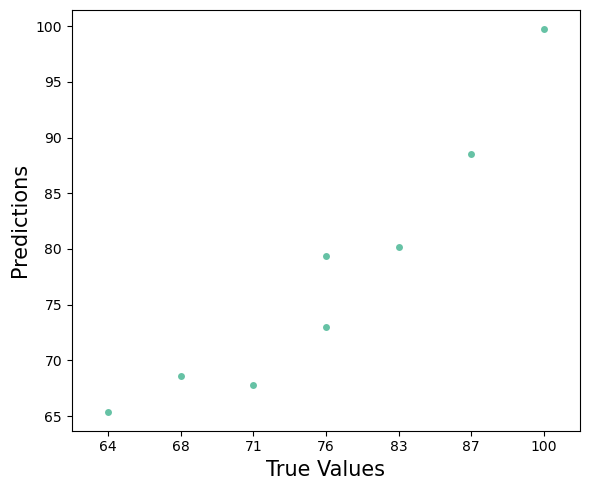

In [79]:
plt.figure(figsize=(6,5))
y_pred=final_model.predict(x_test)
sns.swarmplot(x=y_test.round(2), y=y_pred)
print('\033[1m'+' True Values Vs Predicted Value plot :' +'\033[0m')
plt.xlabel('True Values' , fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.tight_layout()

# Saving the model

In [75]:
import joblib
joblib.dump(final_model,"Baseball Case Study.pkl")

['Baseball Case Study.pkl']

In [76]:
# lets load the saved model and get the predictions
model=joblib.load("Baseball Case Study.pkl")

# Prediction
prediction=model.predict(x_test)
prediction

array([80.15338942, 67.78595459, 73.00509067, 88.53981104, 65.3979252 ,
       99.73350967, 79.3443592 , 68.60742581])

In [77]:
#  compare with the actual test
a=np.array(y_test)
df=pd.DataFrame()
df["Predicted"]=prediction
df["Original"]=a
df

,Predicted,Original
0,80.153389,83
1,67.785955,71
2,73.005091,76
3,88.539811,87
4,65.397925,64
5,99.733510,100
6,79.344359,76
7,68.607426,68


#### Conclusion:

    In this project, we used various machine learning techniques for regressor problem to analyze and predict baseball outcomes. Among the algorithms tested on Ridge Regularization model emerged as the most effective, delivering the highest accuracy. We fine-tuned hyperparameters such as GridSearchCV , which significantly improved the model's performance.

    After rigorous testing and validation, the final model achieved an accuracy of 95% on the test data. This performance demonstrates the potential of machine learning in sports analytics, providing reliable tools for enhancing decision-making in baseball. However, there remains scope for further refinement, such as integrating more granular data or exploring advanced techniques to improve predictions.